In [44]:
import torch
from torch.utils.data import DataLoader, Subset
import torchvision.transforms as transforms
from torchvision.datasets import CIFAR10
from torchvision.models import resnet50
import torch.nn as nn
import matplotlib.pyplot as plt
import random
from torch.nn.functional import pairwise_distance
from torch import optim

In [46]:
def visualize_feature_maps(model, dataloader, layer_name, device, num_inputs=5, num_features=16):
    
    feature_maps = []
    

    # Hook function for feature extraction
    def hook_fn(module, input, output):
        feature_maps.append(output)

    # Register hook
    hook = getattr(model, layer_name).register_forward_hook(hook_fn)

    # Process the first batch
    model.eval()
    inputs, _ = next(iter(dataloader))
    inputs = inputs.to(device)

    with torch.no_grad():
        _ = model(inputs)

    # Visualize the specified number of inputs and their feature maps
    for idx in range(num_inputs):
        feature_map = feature_maps[0][idx].cpu().detach()  # Extract feature map for the current input

        # Create a new figure for each input
        fig, axs = plt.subplots(1, 2, figsize=(12, 6))

        # Display the original image on the left
        original_image = inputs[idx].cpu().permute(1, 2, 0)  # Reorder to HWC
        original_image = original_image * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])  # Unnormalize
        original_image = original_image.clip(0, 1)
        axs[0].imshow(original_image)
        axs[0].axis('off')
        axs[0].set_title("Original Image", fontsize=14)

        # Display the feature maps on the right
        num_features = min(num_features, feature_map.size(0))  # Limit to specified feature maps
        grid_size = int(num_features ** 0.5)
        feature_map_grid = feature_map[:num_features]  # Select a subset of feature maps

        normalized_maps = [fm - fm.min() for fm in feature_map_grid]  # Shift values to start at 0
        normalized_maps = [fm / fm.max() for fm in normalized_maps]  # Scale to range [0, 1]

        combined_maps = torch.cat([
            torch.cat([normalized_maps[i * grid_size + j] for j in range(grid_size)], dim=1)
            for i in range(grid_size)
        ], dim=0)

        axs[1].imshow(combined_maps, cmap='viridis')
        axs[1].axis('off')
        axs[1].set_title("Feature Maps", fontsize=14)


        # Display the figure
        plt.suptitle(layer_name)
        plt.tight_layout()
        plt.show()

    # Remove hook after visualization
    hook.remove()





In [47]:
model = resnet50(pretrained=True)
num_classes = 2
model.fc = nn.Linear(model.fc.in_features, num_classes)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 174MB/s] 


Files already downloaded and verified
Files already downloaded and verified
Feature maps for epoch 0


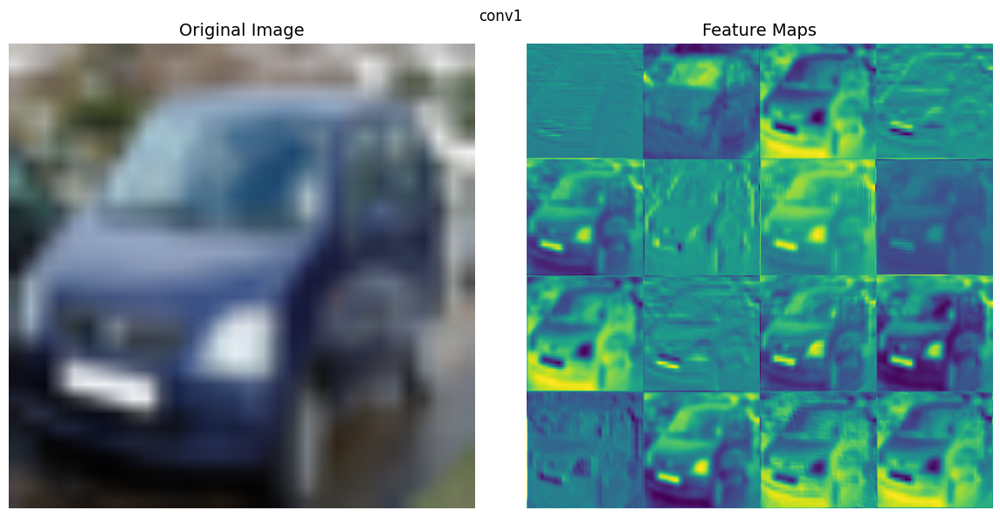

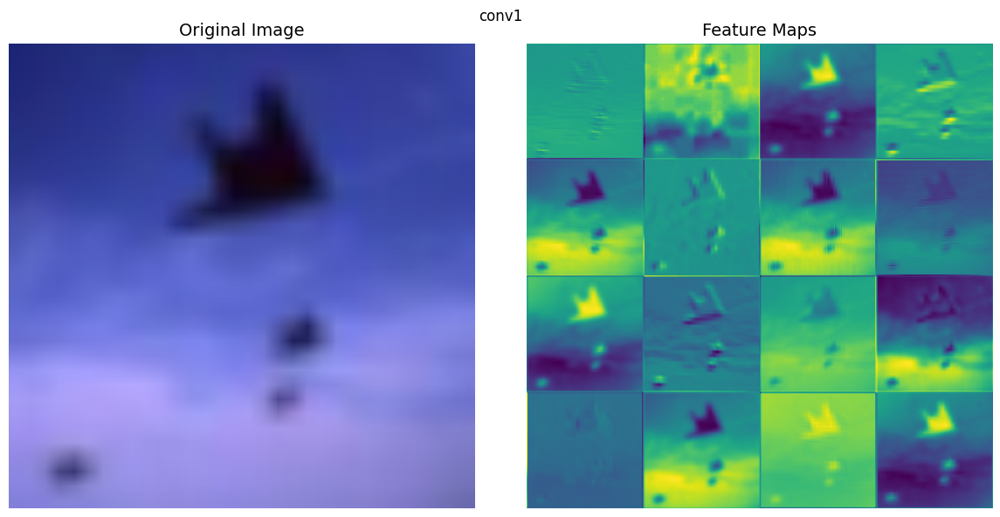

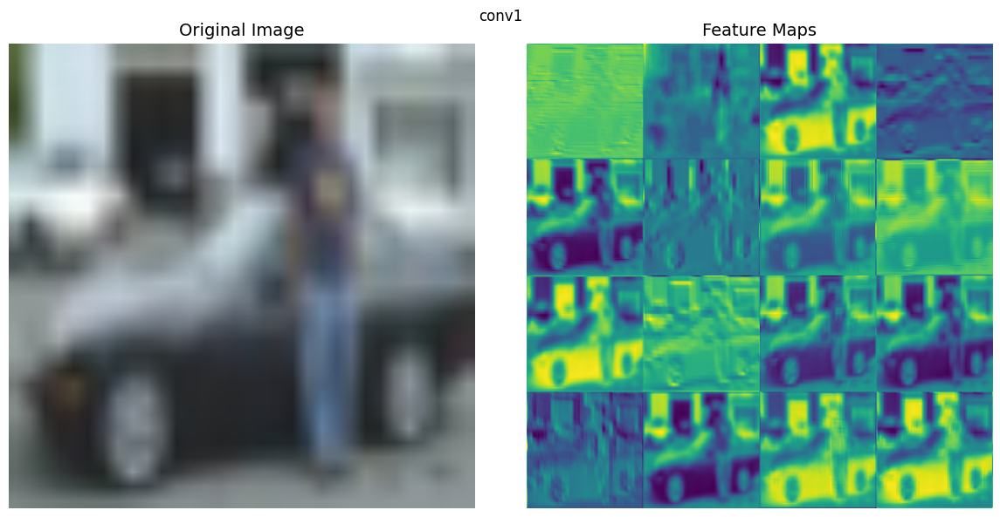

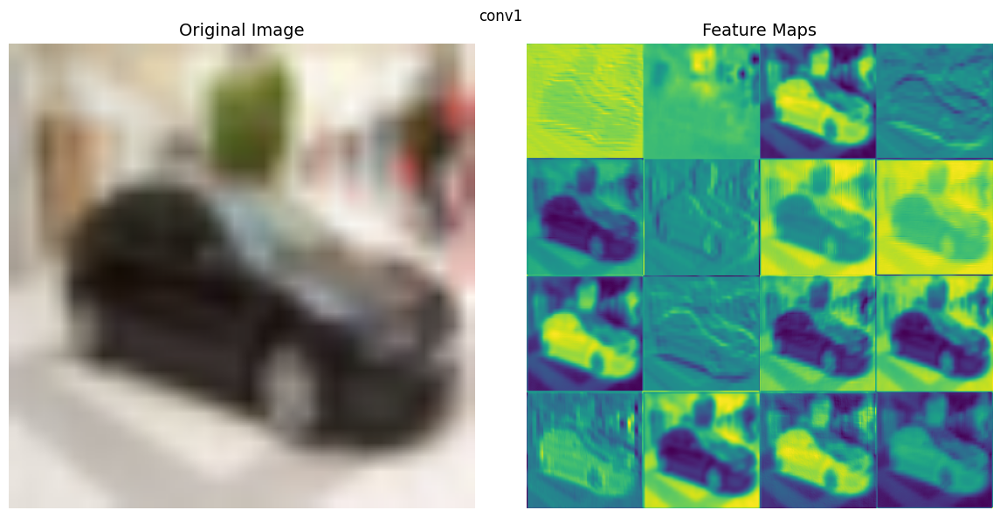

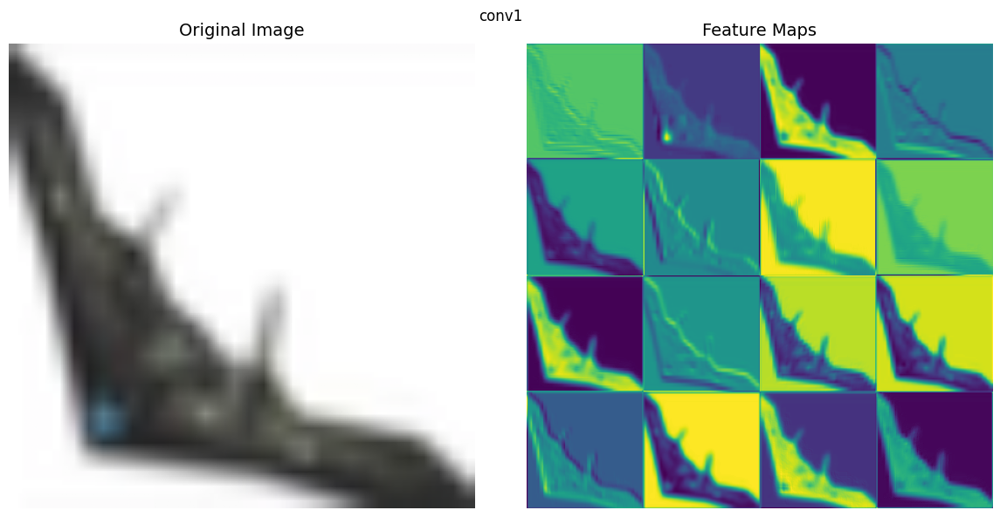

...

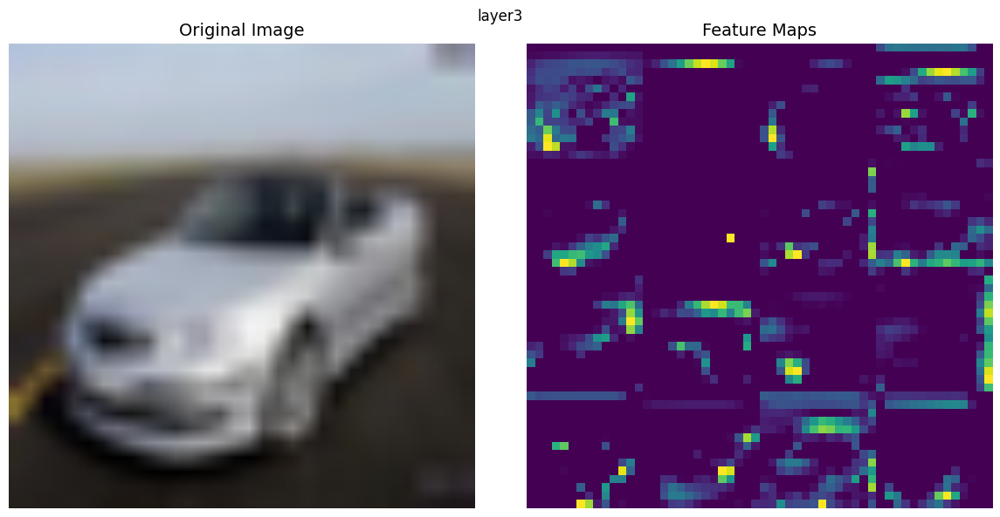

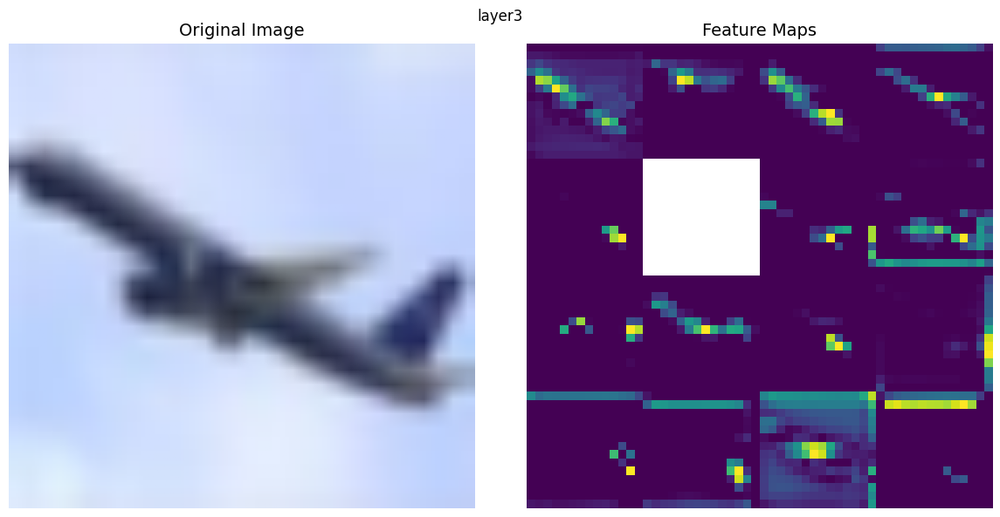

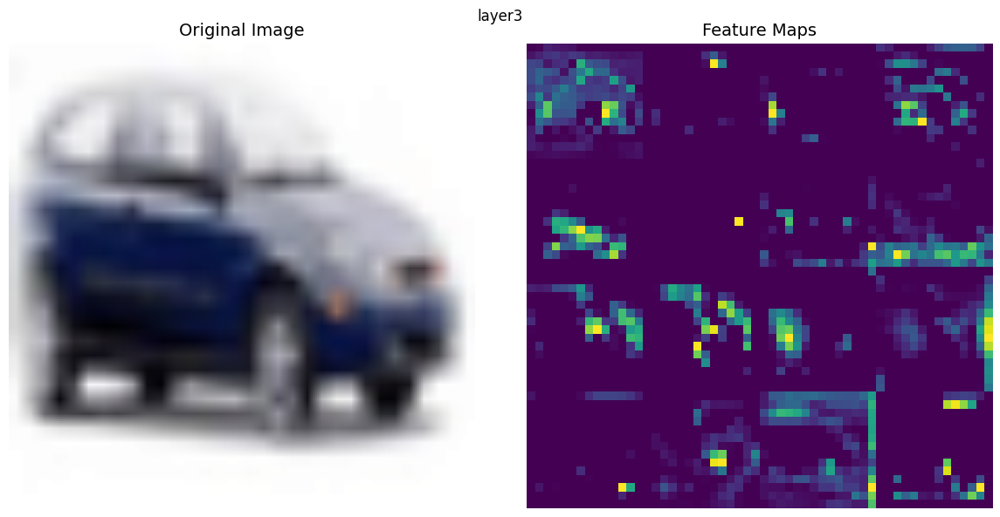

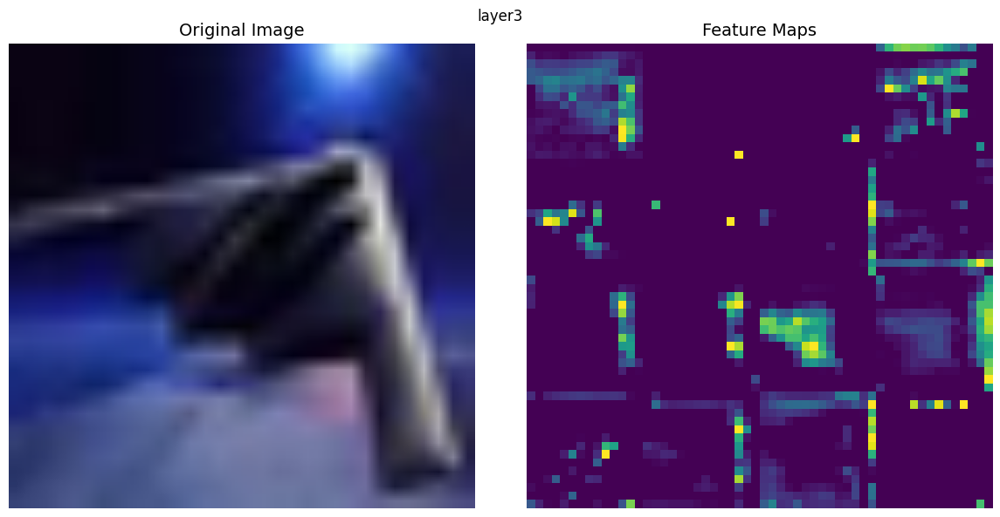

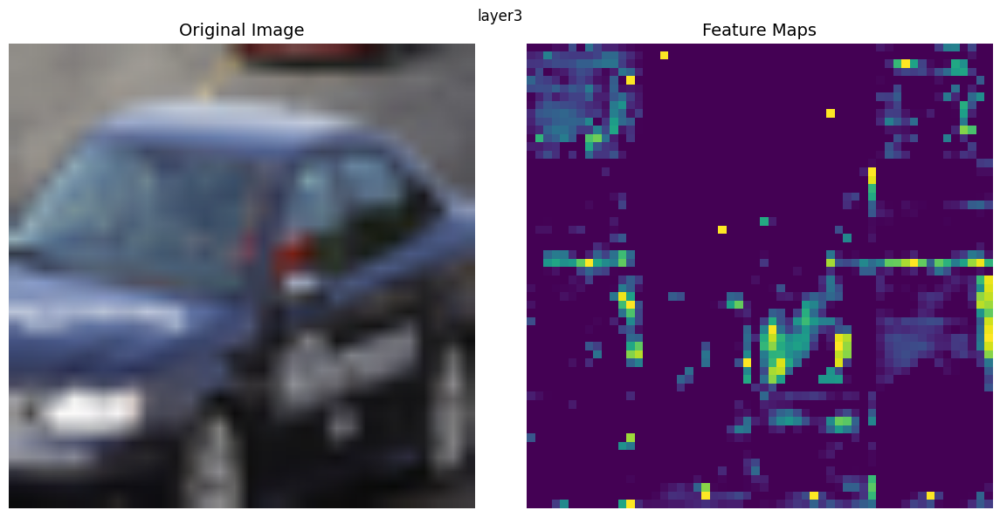

Epoch 1/10, Loss: 0.1941, Accuracy: 92.39%
Epoch 2/10, Loss: 0.1251, Accuracy: 94.99%
Epoch 3/10, Loss: 0.0809, Accuracy: 97.17%
Epoch 4/10, Loss: 0.0744, Accuracy: 97.23%
Epoch 5/10, Loss: 0.0686, Accuracy: 97.45%
Feature maps for epoch 5


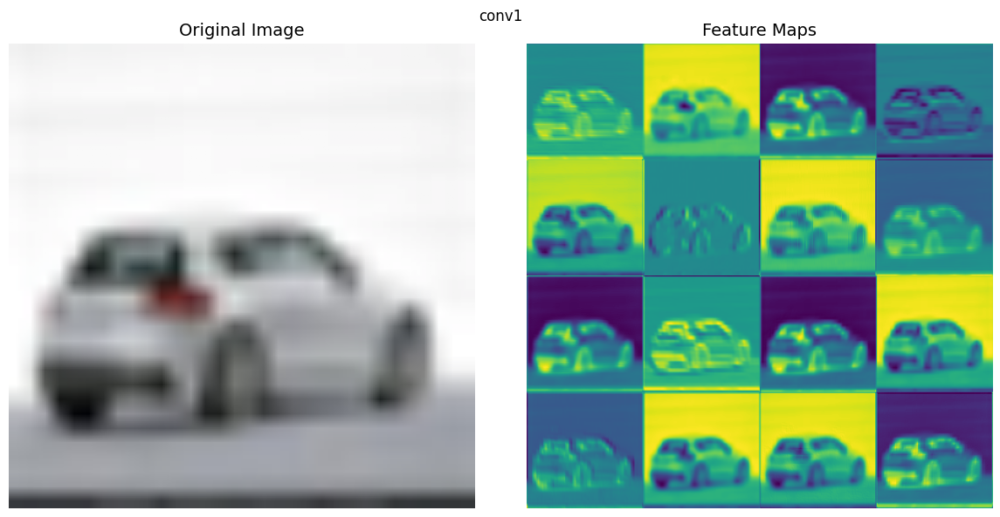

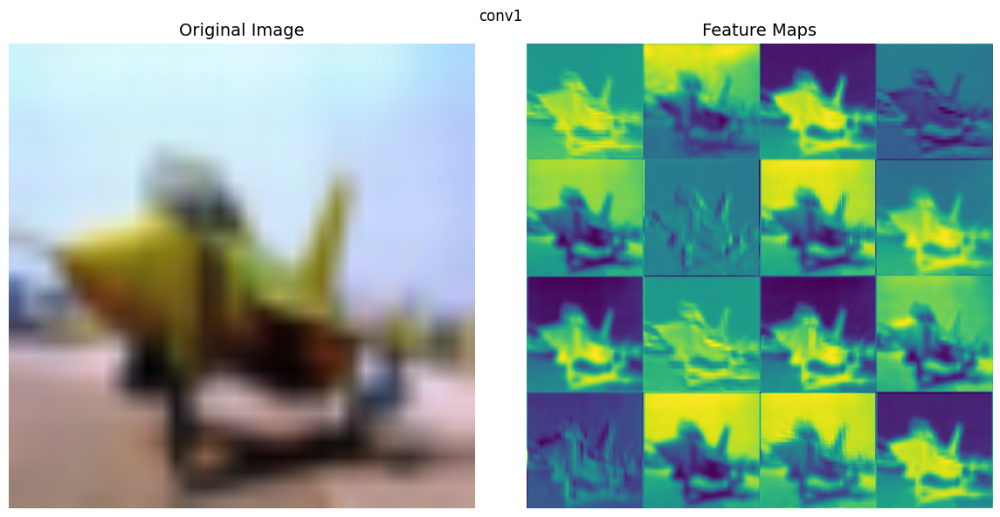

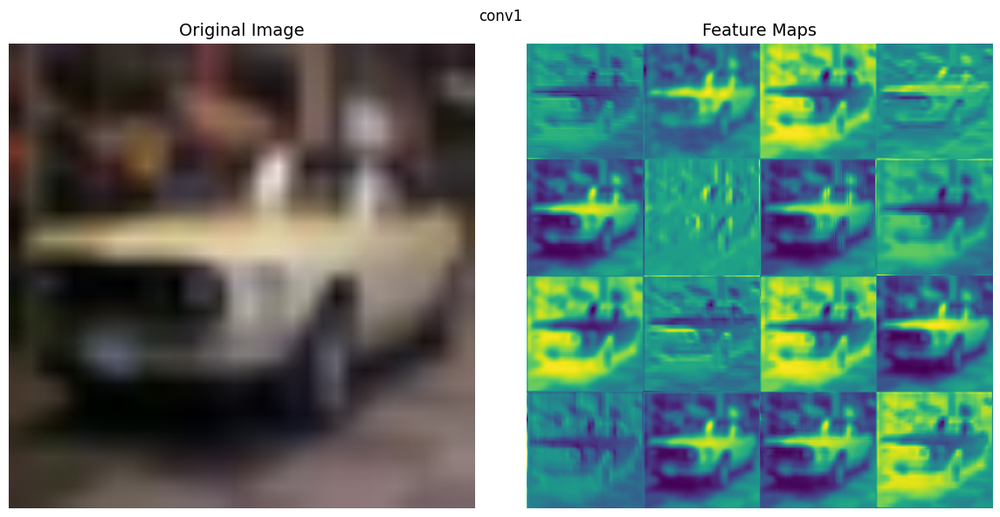

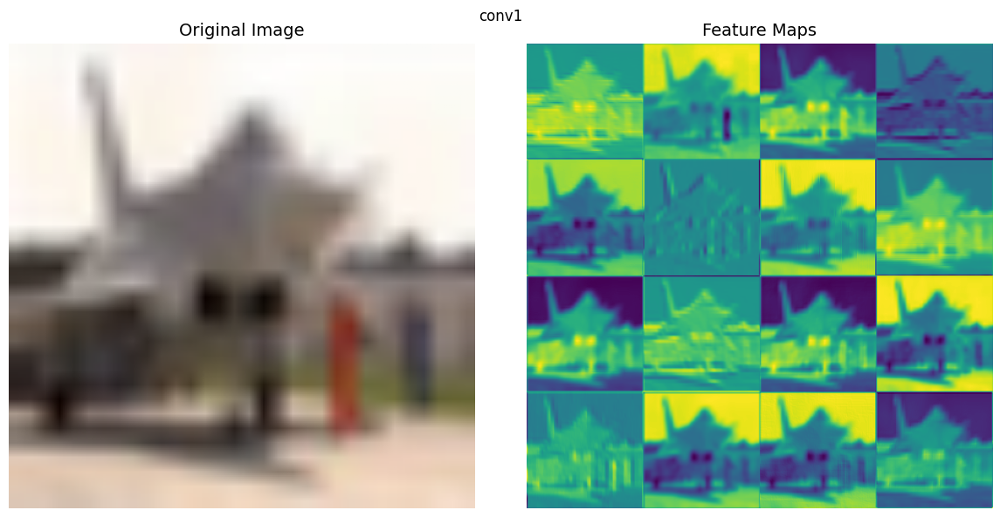

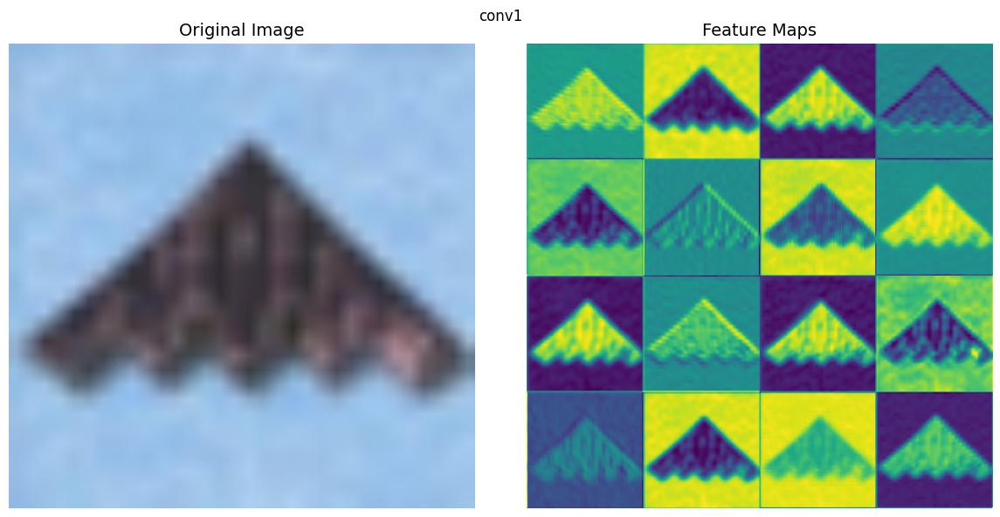

...

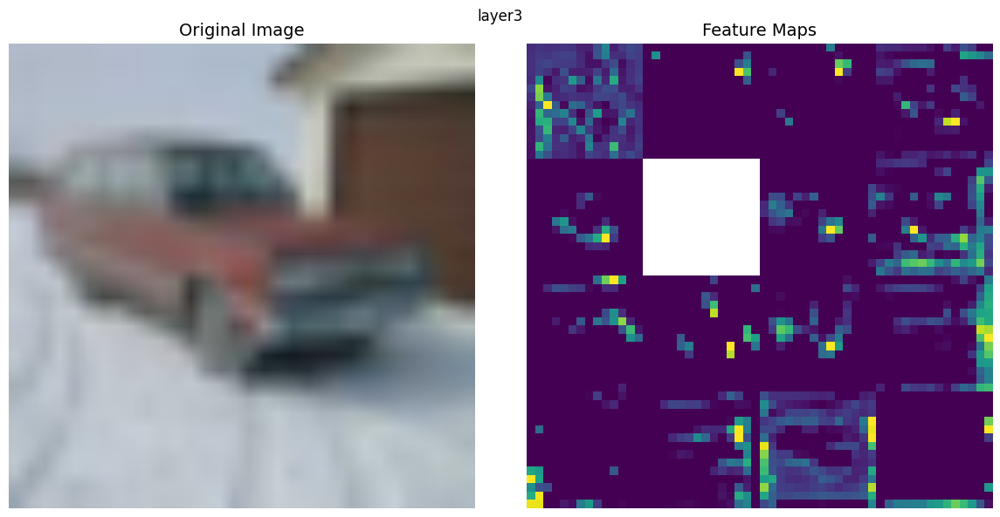

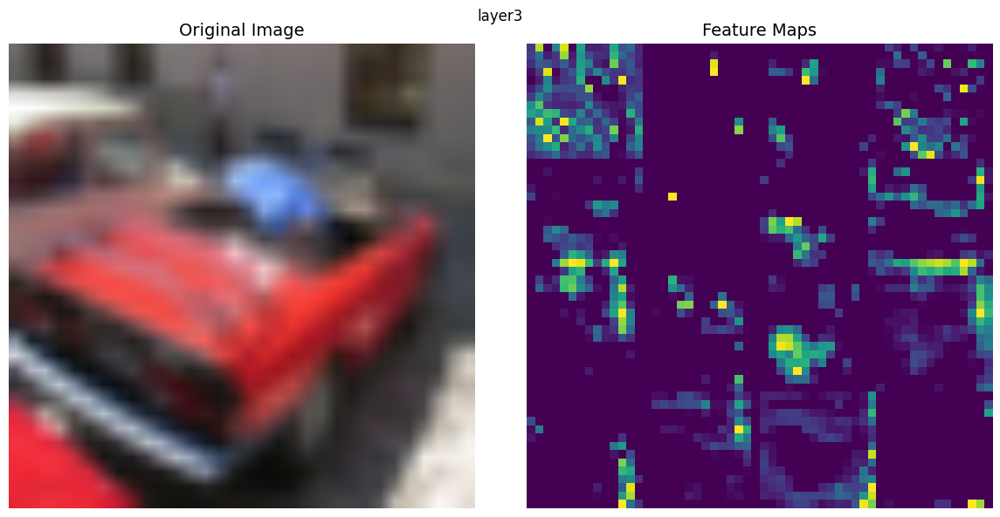

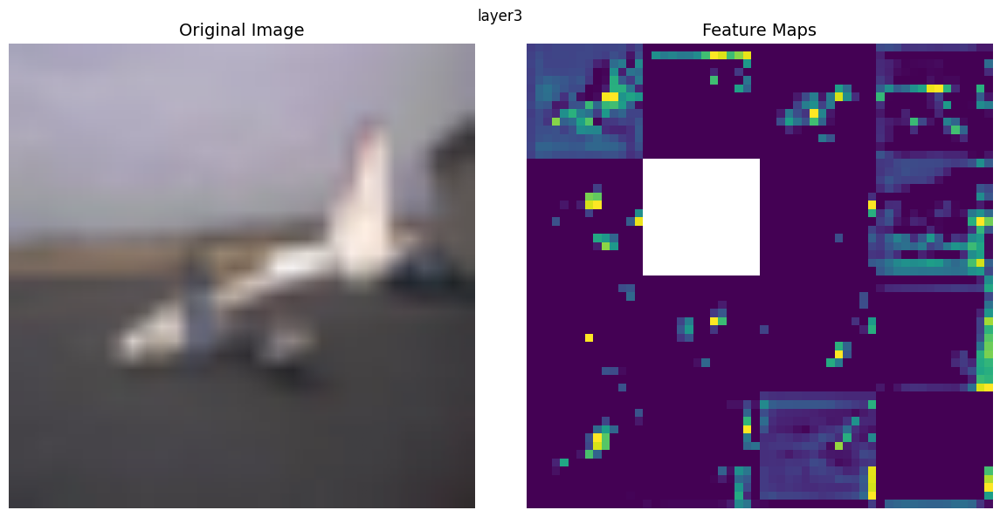

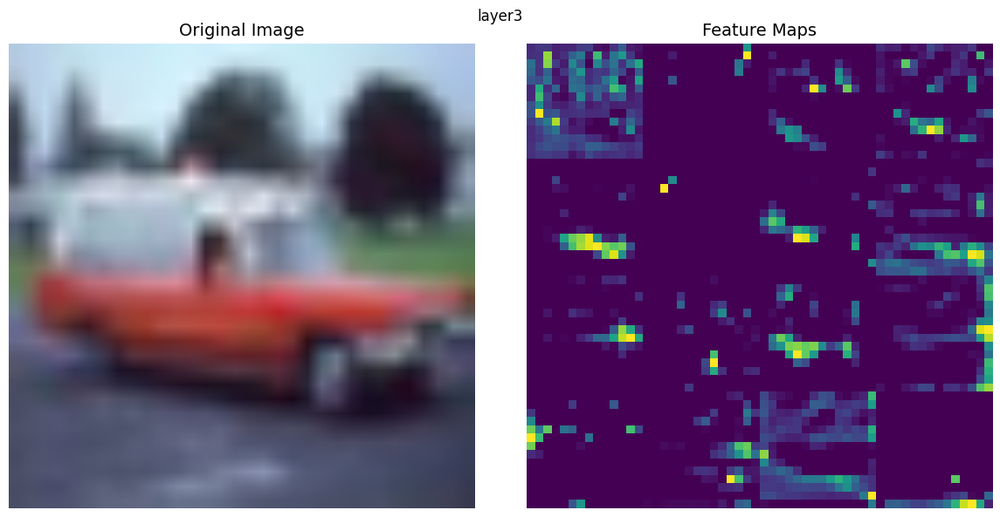

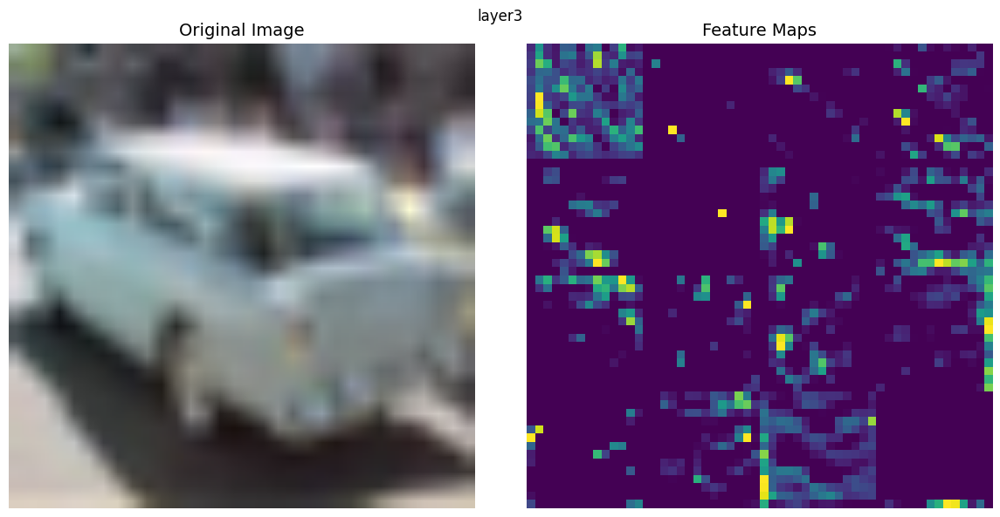

Epoch 6/10, Loss: 0.0591, Accuracy: 97.66%
Epoch 7/10, Loss: 0.0469, Accuracy: 98.39%
Epoch 8/10, Loss: 0.0461, Accuracy: 98.33%
Epoch 9/10, Loss: 0.0422, Accuracy: 98.42%
Epoch 10/10, Loss: 0.0391, Accuracy: 98.59%


In [48]:
# Data preprocessing and loading
transform = transforms.Compose([
    transforms.Resize(224),  # Resize for ResNet-50
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
train_dataset = CIFAR10(root='./data', train=True, download=True, transform=transform)
test_dataset = CIFAR10(root='./data', train=False, download=True, transform=transform)

class_indices = [0, 1]  # Airplane and Automobile
train_binary_indices = [i for i, (_, label) in enumerate(train_dataset) if label in class_indices]
test_binary_indices = [i for i, (_, label) in enumerate(test_dataset) if label in class_indices]

train_binary_dataset = Subset(train_dataset, train_binary_indices)
test_binary_dataset = Subset(test_dataset, test_binary_indices)

train_dataloader = DataLoader(train_binary_dataset, batch_size=32, shuffle=True)
test_dataloader = DataLoader(test_binary_dataset, batch_size=32, shuffle=False)

# Model, loss, optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

num_epochs=10
layer_names = ['conv1','layer1','layer2','layer3']
# Training
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    for i,(inputs, labels) in enumerate(train_dataloader,0):
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        loss = criterion(outputs, labels)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    avg_loss = running_loss / (i + 1)
    accuracy = 100 * correct / total
        
    if epoch%5==0:
        print(f'Feature maps for epoch {epoch}')
        for layer_name in layer_names:
            visualize_feature_maps(model, train_dataloader, layer_name, device)
    

    print(f'Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%')

Since using ResNet50 for next parts takes ages, I defined a custom cnn.

In [31]:
import torch
from torch.utils.data import DataLoader, Subset
import torchvision.transforms as transforms
from torchvision.datasets import CIFAR10
from torchvision.models import resnet50
import torch.nn as nn
import matplotlib.pyplot as plt
import random
from torch.nn.functional import pairwise_distance
from torch import optim

In [32]:
class CustomCNN(nn.Module):
    def __init__(self, num_classes):
        super(CustomCNN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.fc = nn.Sequential(
            nn.Flatten(),
            nn.Linear(128 * 4 * 4, 256),
            nn.ReLU(),
            nn.Linear(256, num_classes)
        )

    def forward(self, x):
        x = self.features(x)
        x = self.fc(x)
        return x

class TripletCIFAR10(CIFAR10):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.label_to_indices = {label: [] for label in range(10)}
        for i, label in enumerate(self.targets):
            self.label_to_indices[label].append(i)

    def __getitem__(self, index):
        anchor, label = super().__getitem__(index)
        positive_index = random.choice(self.label_to_indices[label])
        while positive_index == index:
            positive_index = random.choice(self.label_to_indices[label])

        negative_label = random.choice([l for l in self.label_to_indices.keys() if l != label])
        negative_index = random.choice(self.label_to_indices[negative_label])

        positive, _ = super().__getitem__(positive_index)
        negative, _ = super().__getitem__(negative_index)

        return anchor, positive, negative, label

In [33]:
# Data preprocessing and loading
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])
train_dataset = TripletCIFAR10(root='./data', train=True, download=True, transform=transform)
test_dataset = TripletCIFAR10(root='./data', train=False, download=True, transform=transform)

class_indices = [0, 1]  # Airplane and Automobile
train_binary_indices = [i for i, (_,_,_, label) in enumerate(train_dataset,0) if label in class_indices]
test_binary_indices = [i for i, (_,_,_, label) in enumerate(test_dataset,0) if label in class_indices]

train_binary_dataset = Subset(train_dataset, train_binary_indices)
test_binary_dataset = Subset(test_dataset, test_binary_indices)

train_loader = DataLoader(train_binary_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_binary_dataset, batch_size=32, shuffle=False)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

Files already downloaded and verified
Files already downloaded and verified


In [34]:
def visualize_feature_maps(model, dataloader, layer_name, device, num_inputs=5, num_features=16, output_index=0):

    feature_maps = []

    # Hook function for feature extraction
    def hook_fn(module, input, output):
        feature_maps.append(output)

    # Register hook
    hook = getattr(model.features, layer_name).register_forward_hook(hook_fn)

    # Process the first batch
    model.eval()
    inputs, _,_,_ = next(iter(dataloader))
    inputs = inputs.to(device)

    with torch.no_grad():
        outputs = model(inputs)
        if isinstance(outputs, (list, tuple)):
            outputs = outputs[output_index]  # Focus on the specified output

    # Visualize the specified number of inputs and their feature maps
    for idx in range(min(num_inputs, len(inputs))):
        feature_map = feature_maps[0][idx].cpu().detach()  # Extract feature map for the current input

        # Create a new figure for each input
        fig, axs = plt.subplots(1, 2, figsize=(12, 6))

        # Display the original image on the left
        original_image = inputs[idx].cpu().permute(1, 2, 0)  # Reorder to HWC
        original_image = (original_image * torch.tensor([0.5, 0.5, 0.5])) + torch.tensor([0.5, 0.5, 0.5])  # Unnormalize
        original_image = original_image.clip(0, 1)
        axs[0].imshow(original_image)
        axs[0].axis('off')
        axs[0].set_title("Original Image", fontsize=14)

        # Display the feature maps on the right
        num_features = min(num_features, feature_map.size(0))  # Limit to specified feature maps
        grid_size = int(num_features ** 0.5)
        feature_map_grid = feature_map[:num_features]  # Select a subset of feature maps

        normalized_maps = [fm - fm.min() for fm in feature_map_grid]  # Shift values to start at 0
        normalized_maps = [fm / fm.max() for fm in normalized_maps]  # Scale to range [0, 1]

        combined_maps = torch.cat([
            torch.cat([normalized_maps[i * grid_size + j] for j in range(grid_size) if i * grid_size + j < len(normalized_maps)], dim=1)
            for i in range(grid_size)
        ], dim=0)

        axs[1].imshow(combined_maps, cmap='viridis')
        axs[1].axis('off')
        axs[1].set_title("Feature Maps", fontsize=14)

        # Display the figure
        plt.suptitle(f"Layer: {layer_name}")
        plt.tight_layout()
        plt.show()

    # Remove hook after visualization
    hook.remove()


Feature maps before training


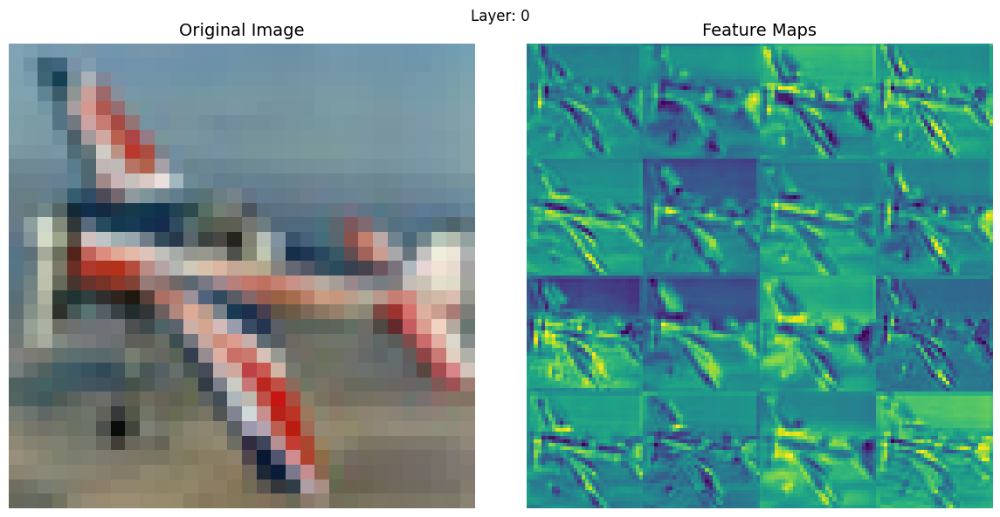

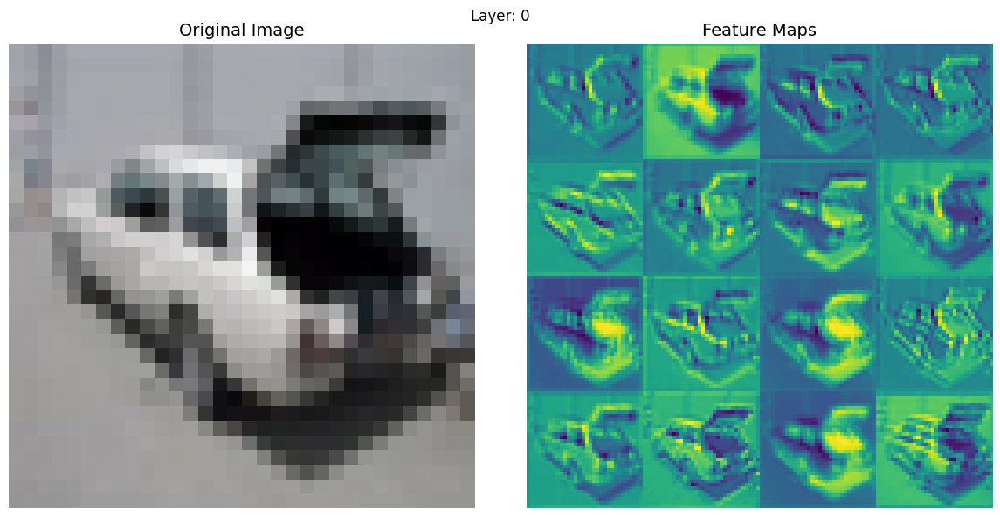

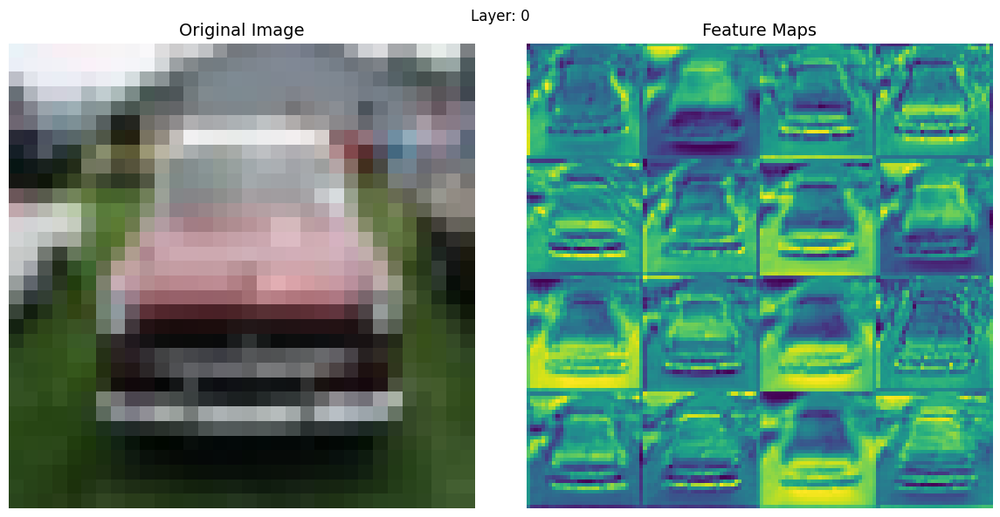

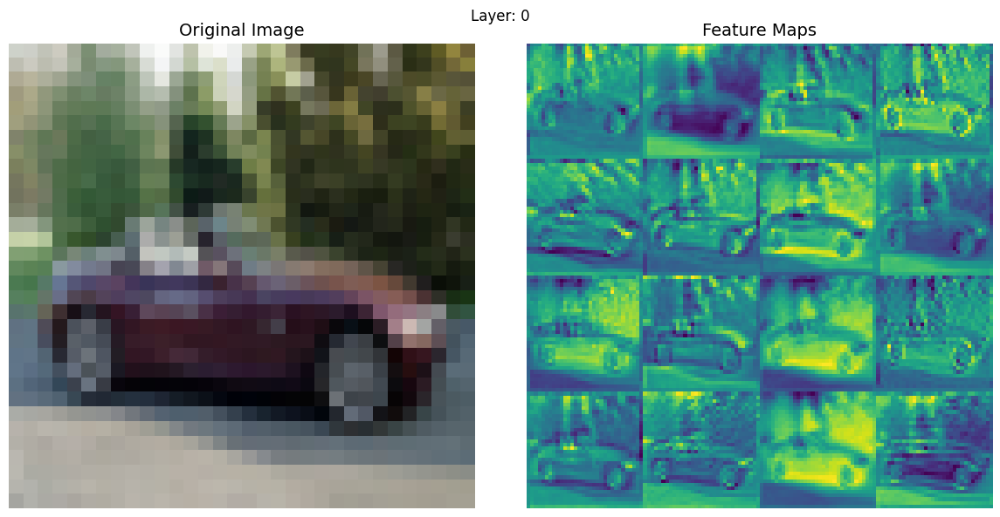

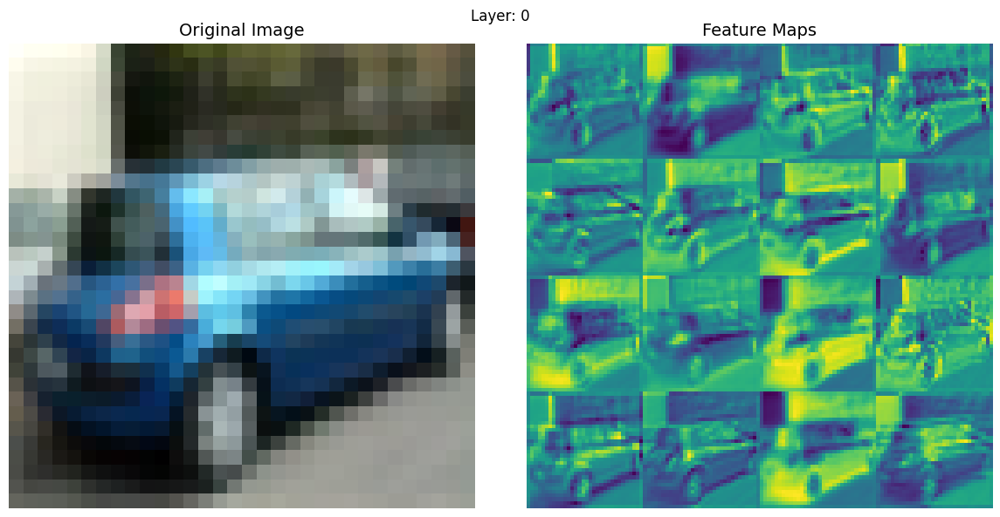

...

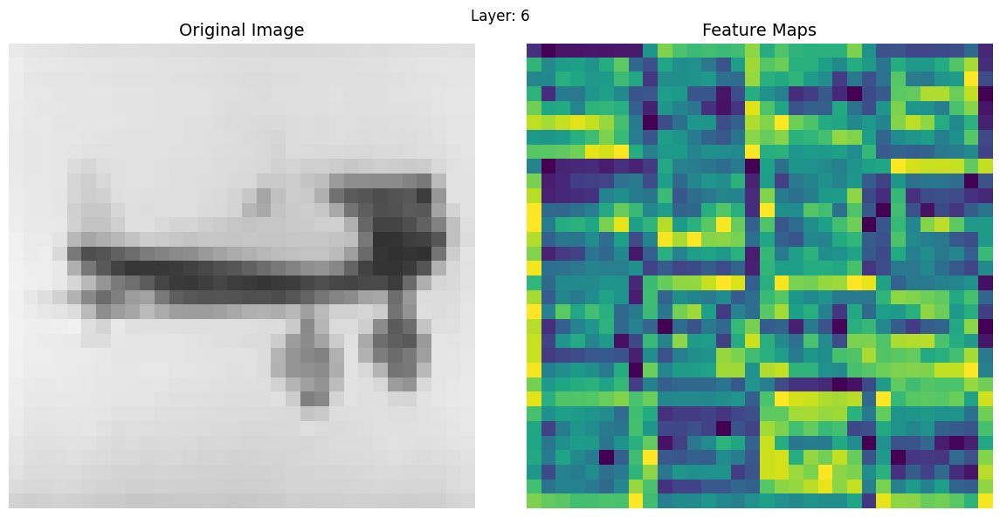

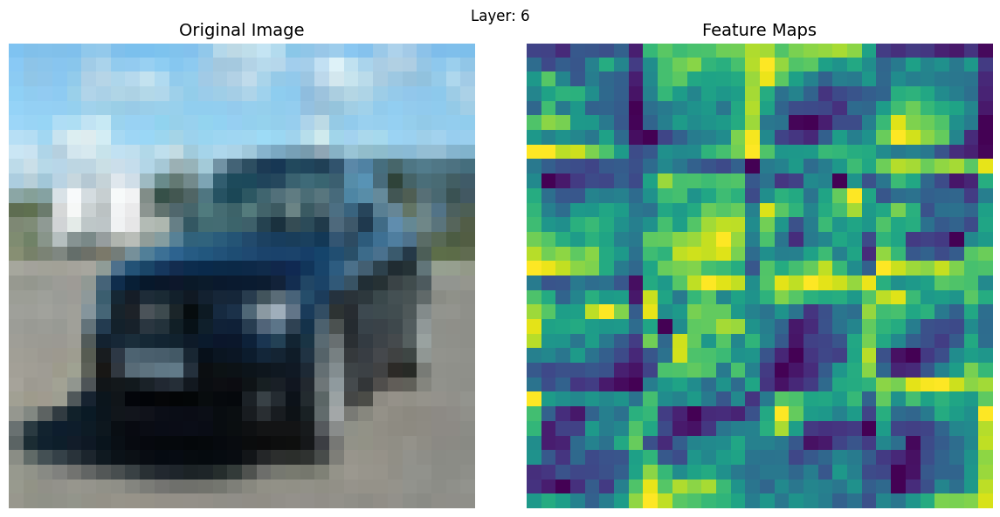

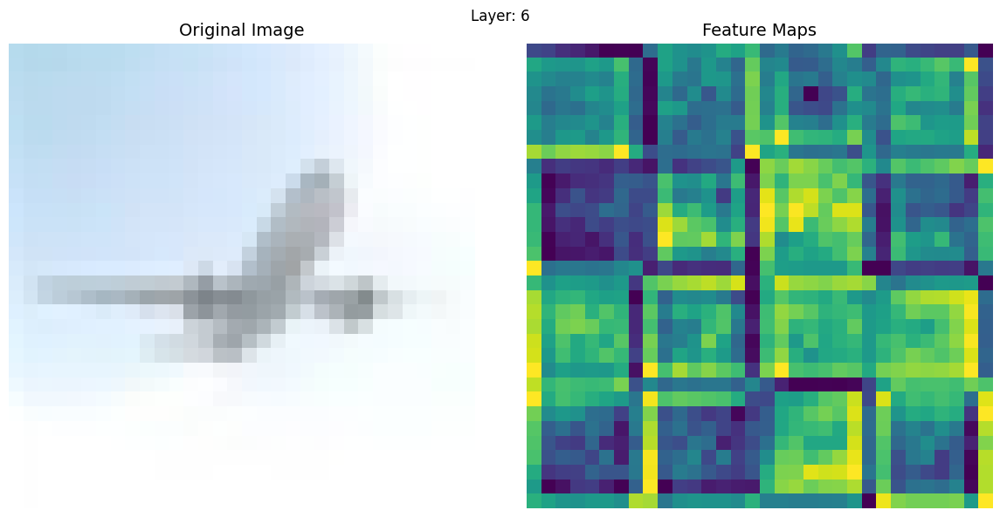

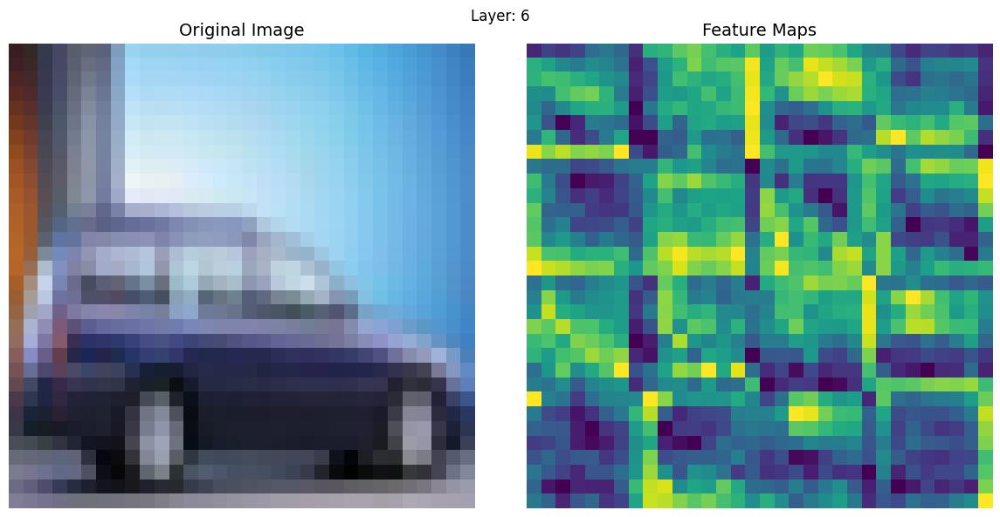

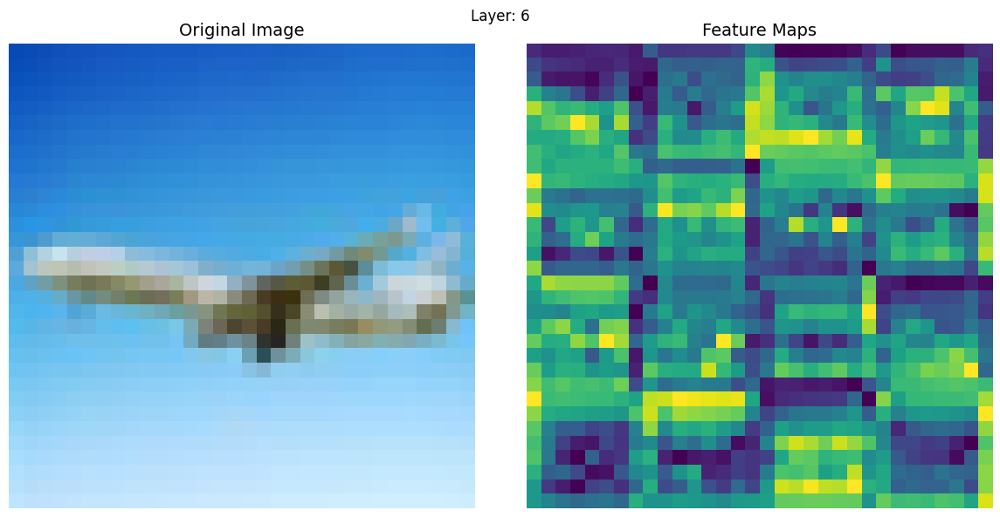

Training:
Feature maps for epoch 1


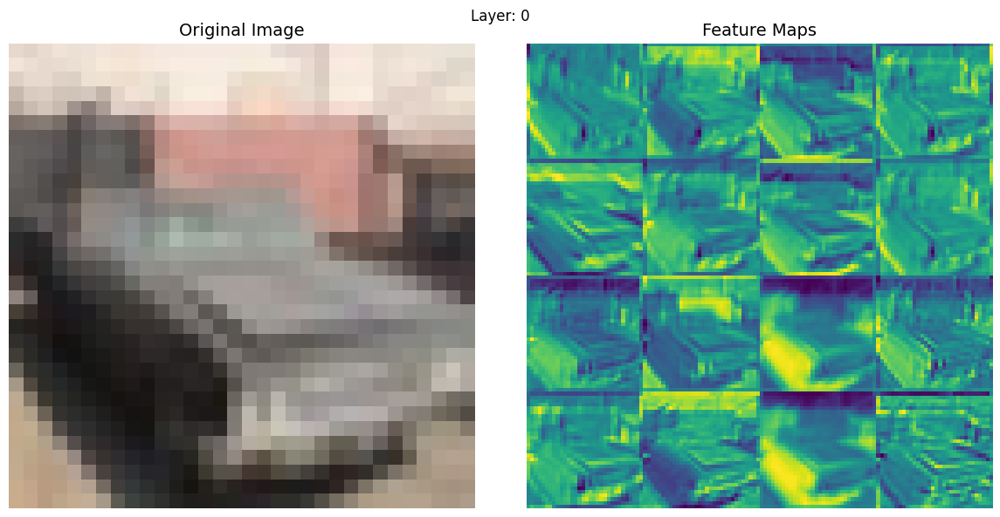

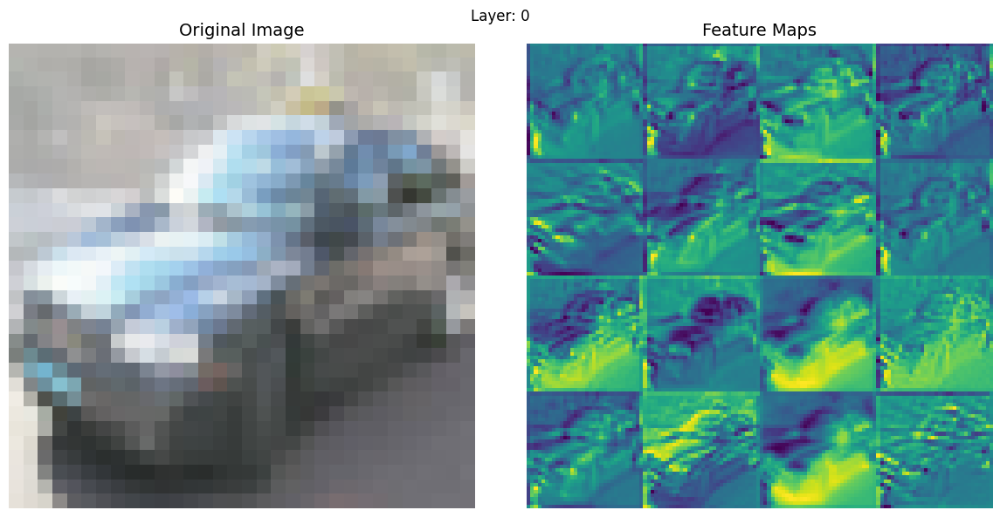

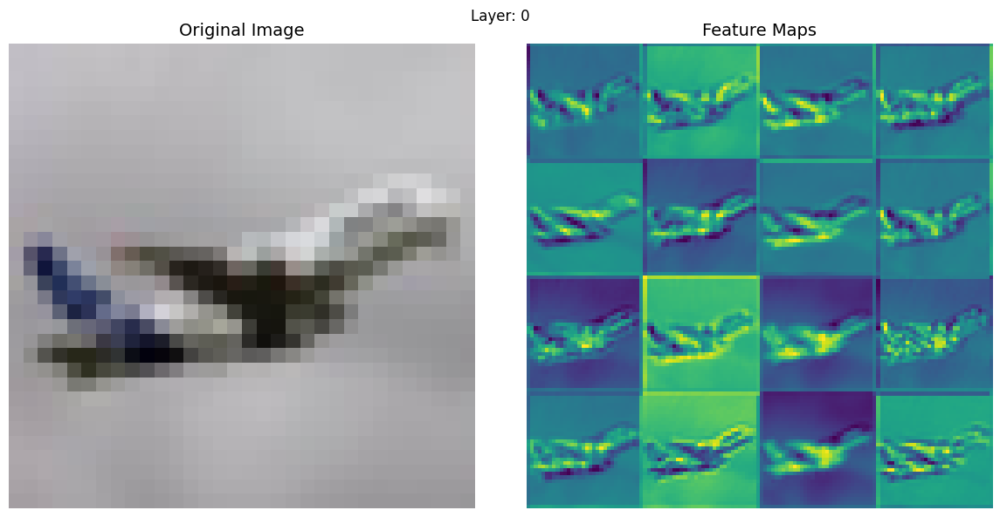

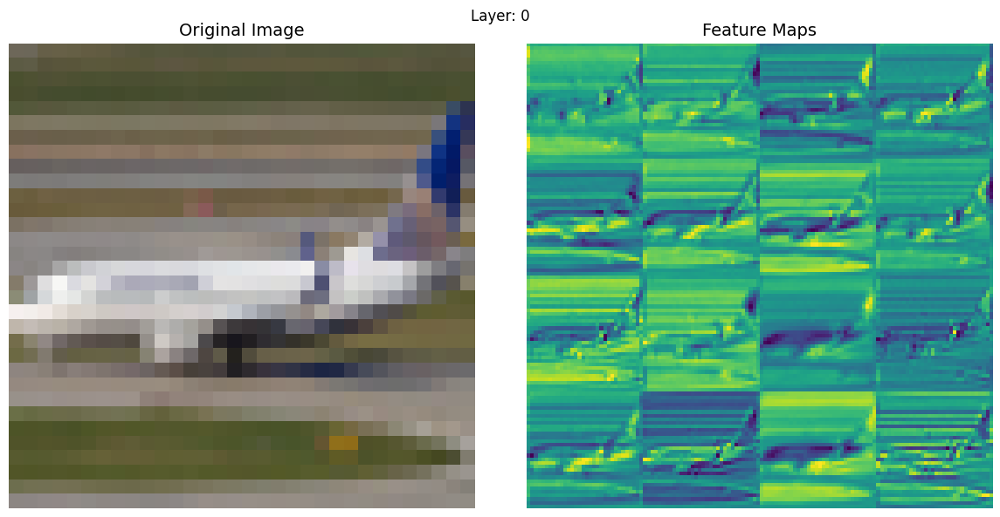

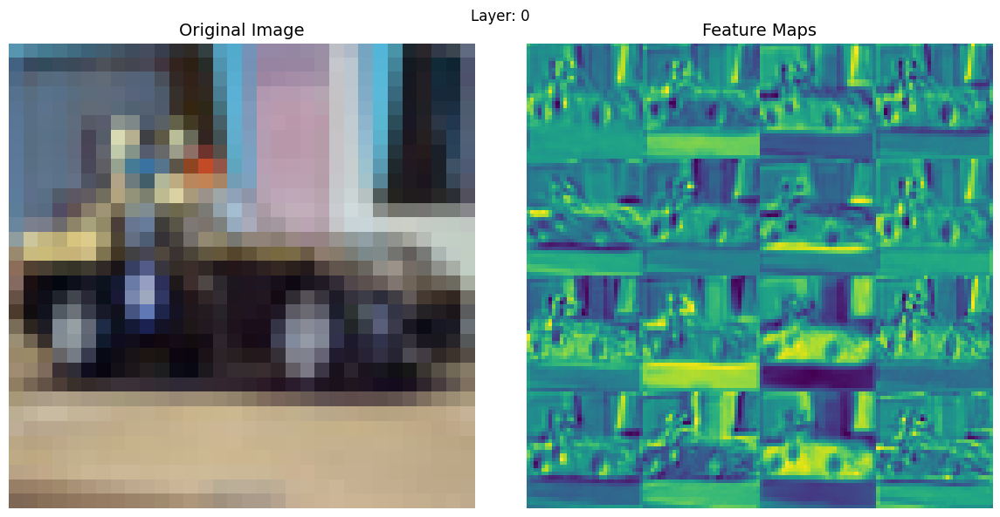

...

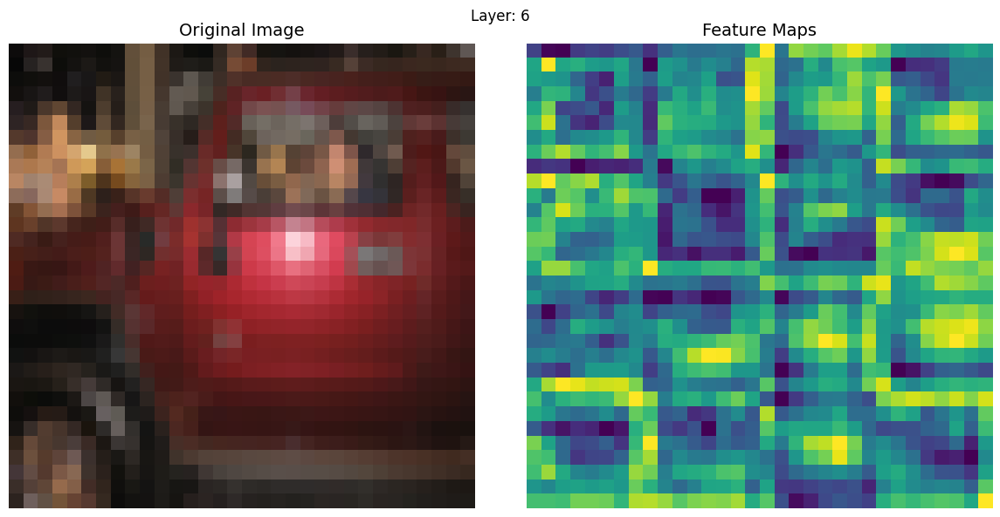

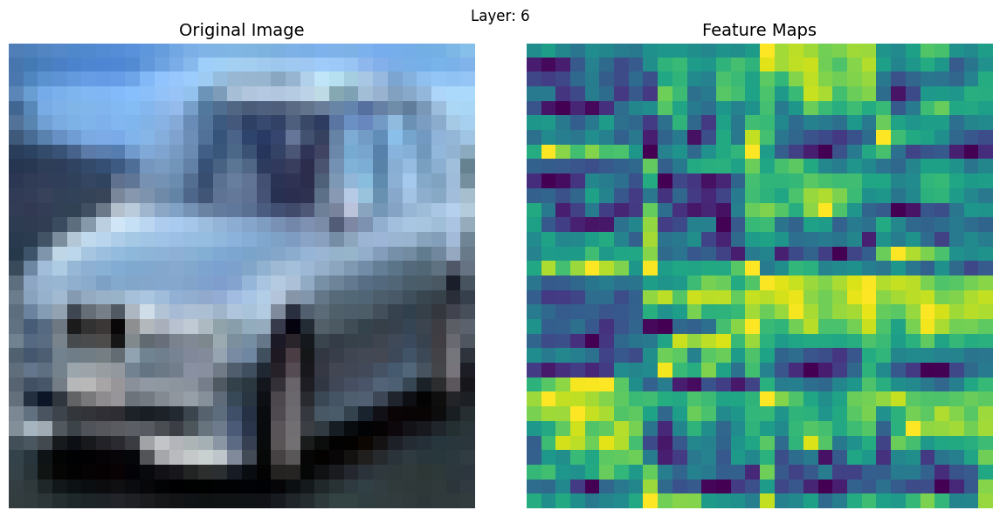

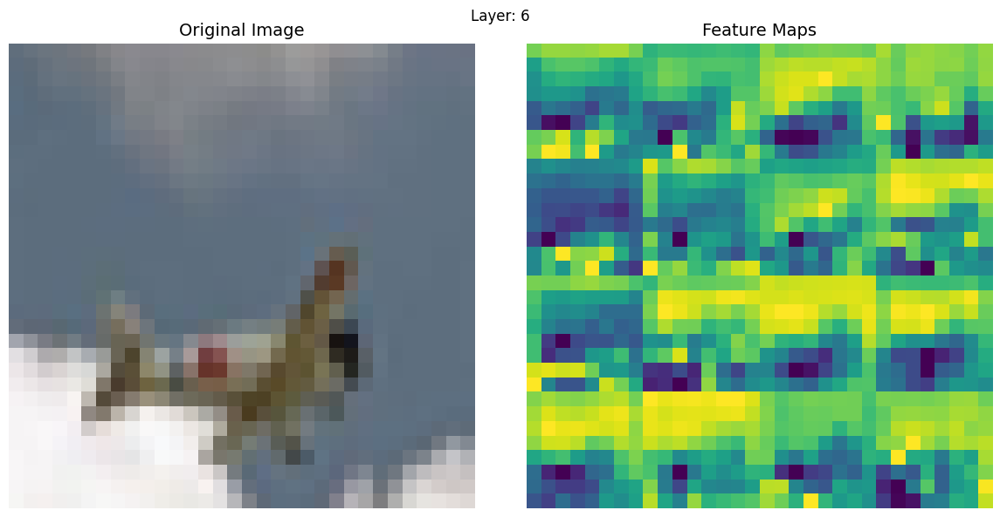

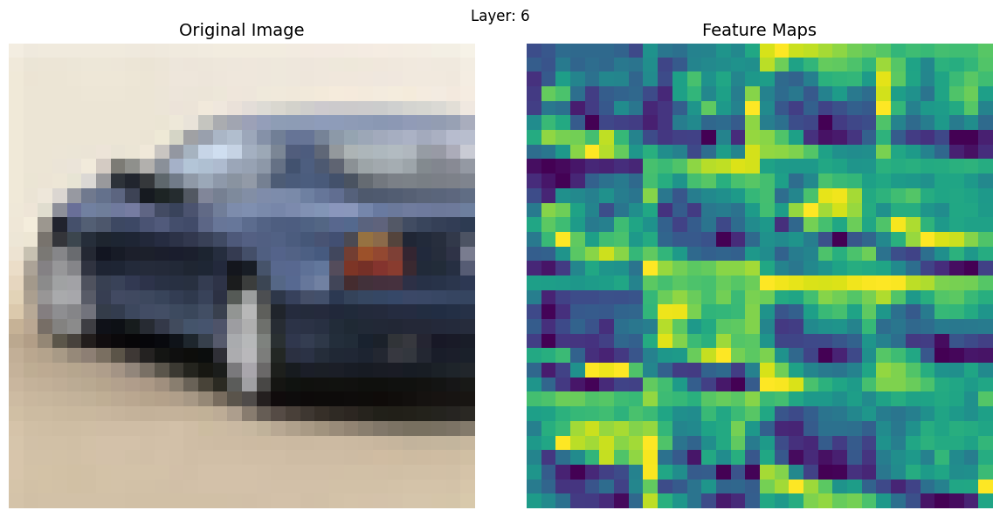

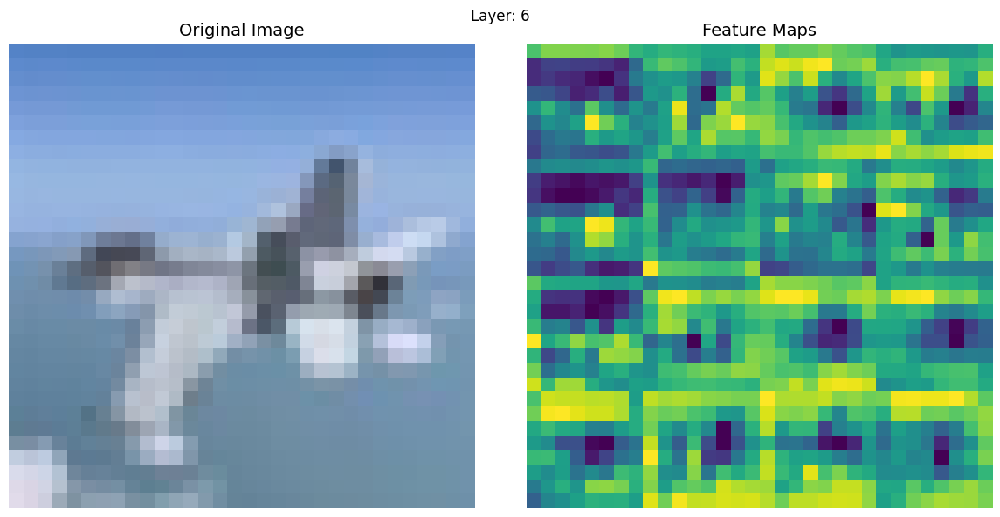

Epoch 1/10, Loss: 0.3094, Accuracy: 85.84%
Epoch 2/10, Loss: 0.1593, Accuracy: 93.69%
Epoch 3/10, Loss: 0.1086, Accuracy: 95.78%
Epoch 4/10, Loss: 0.0842, Accuracy: 96.58%
Epoch 5/10, Loss: 0.0622, Accuracy: 97.66%
Feature maps for epoch 6


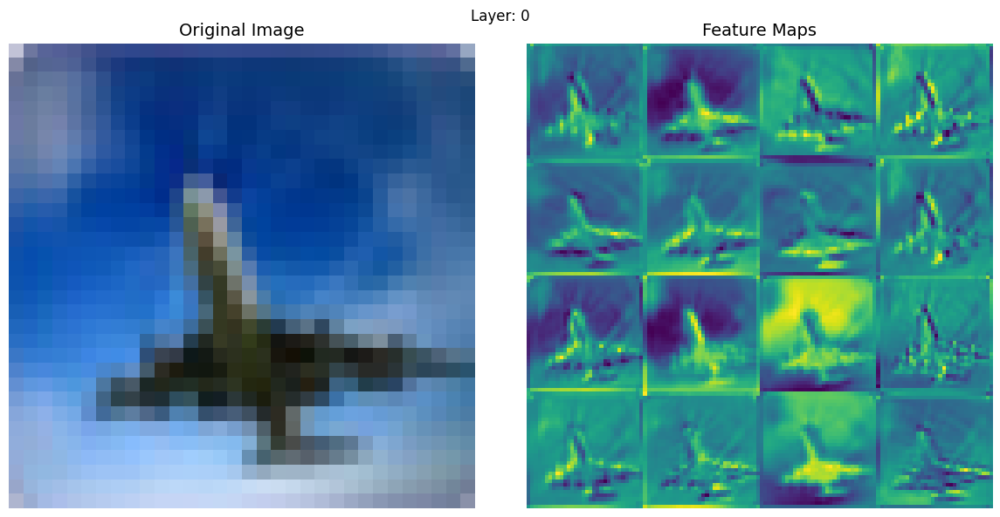

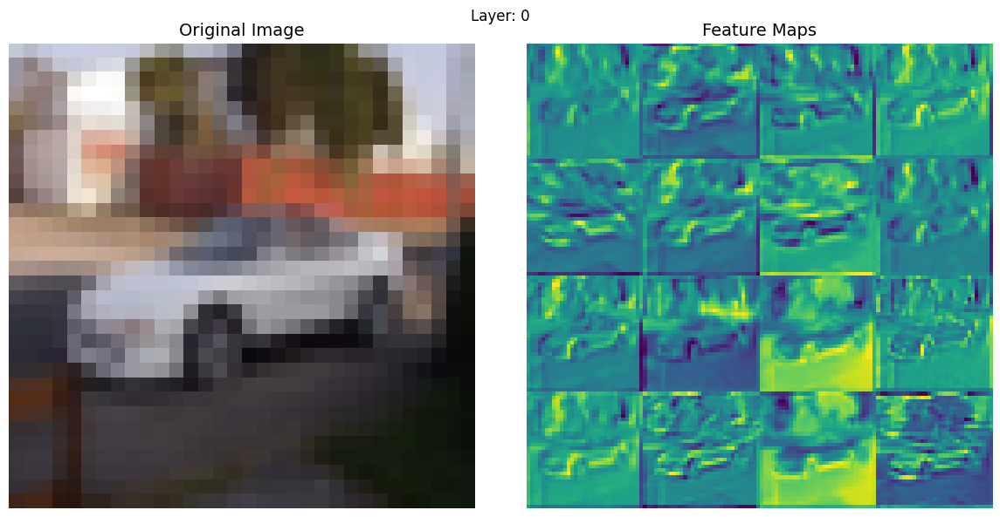

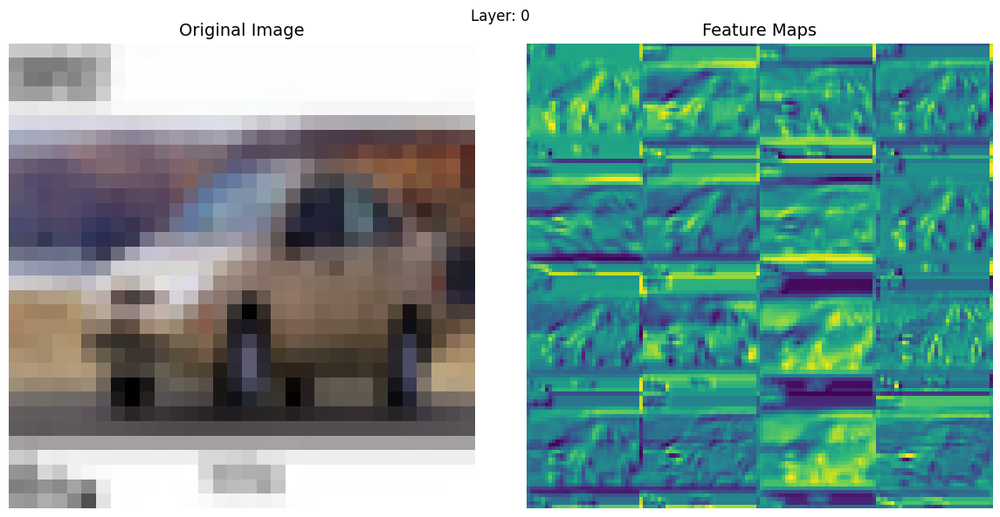

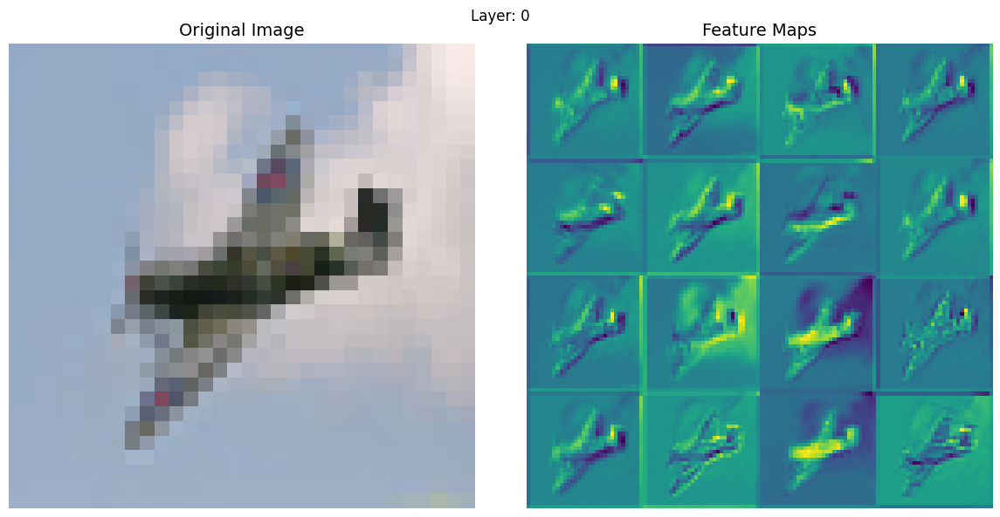

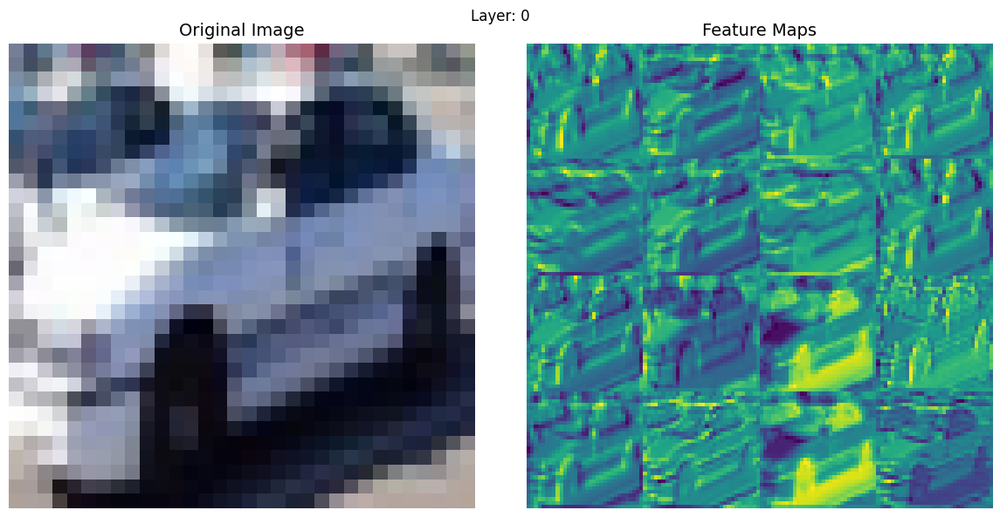

...

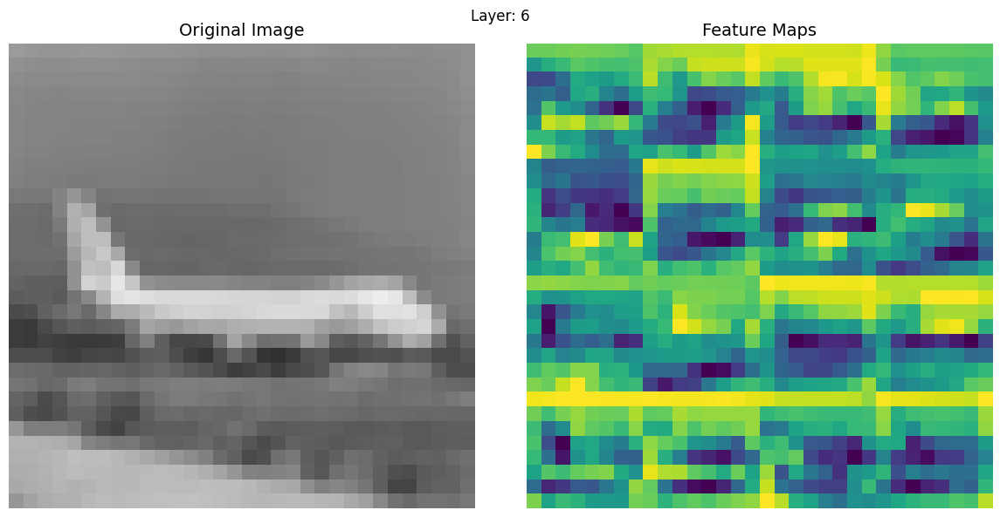

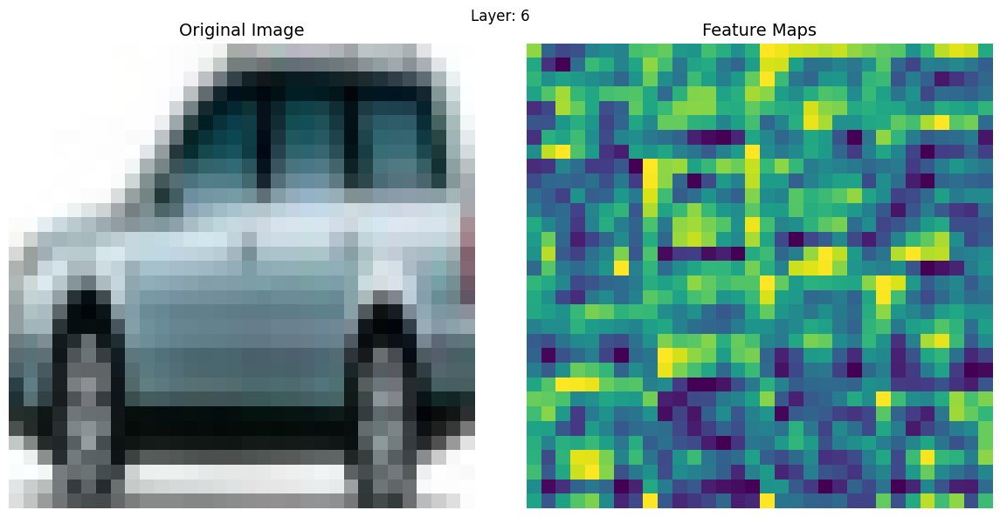

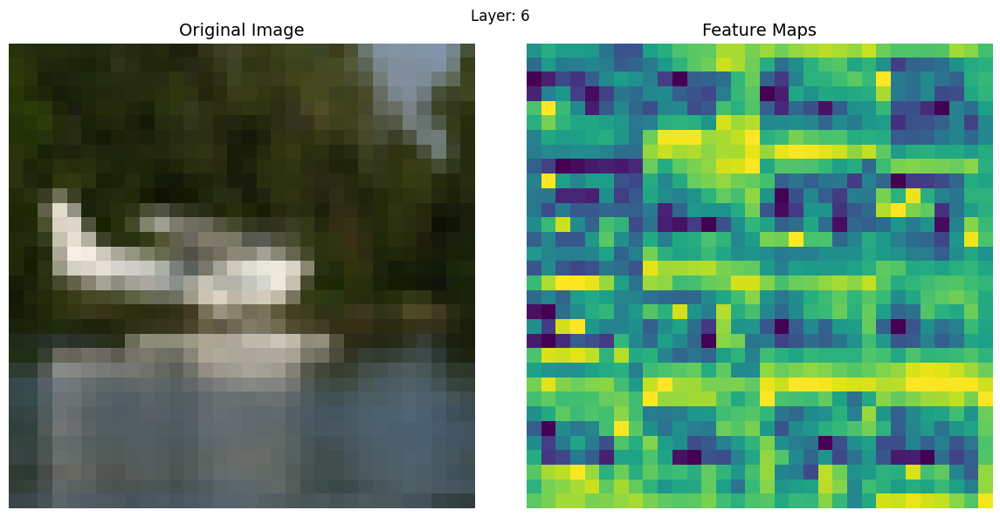

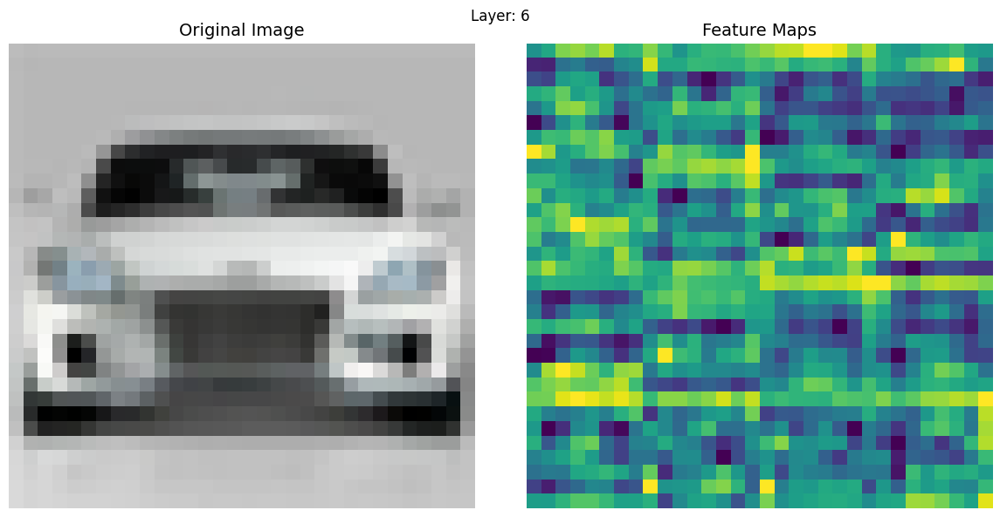

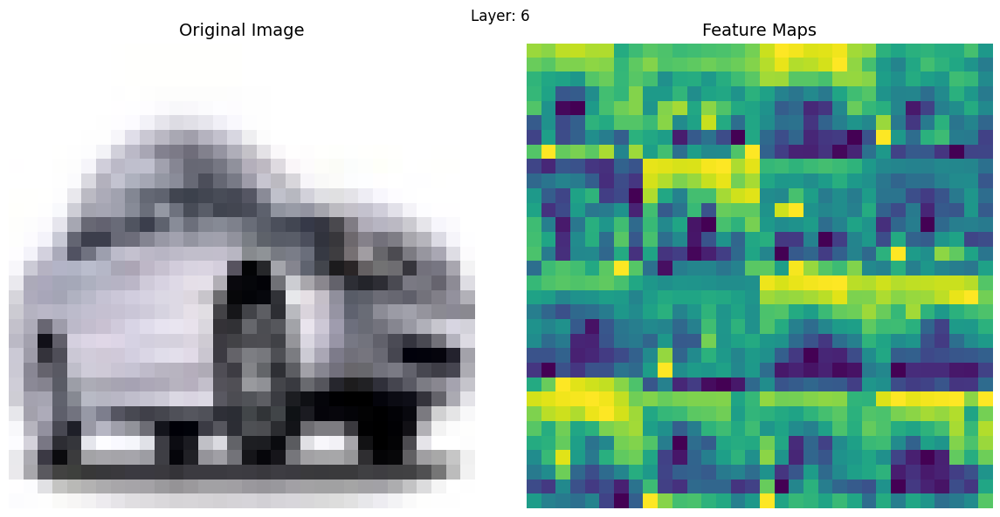

Epoch 6/10, Loss: 0.0399, Accuracy: 98.38%
Epoch 7/10, Loss: 0.0317, Accuracy: 98.88%
Epoch 8/10, Loss: 0.0281, Accuracy: 98.98%
Epoch 9/10, Loss: 0.0181, Accuracy: 99.27%
Feature maps for epoch 10


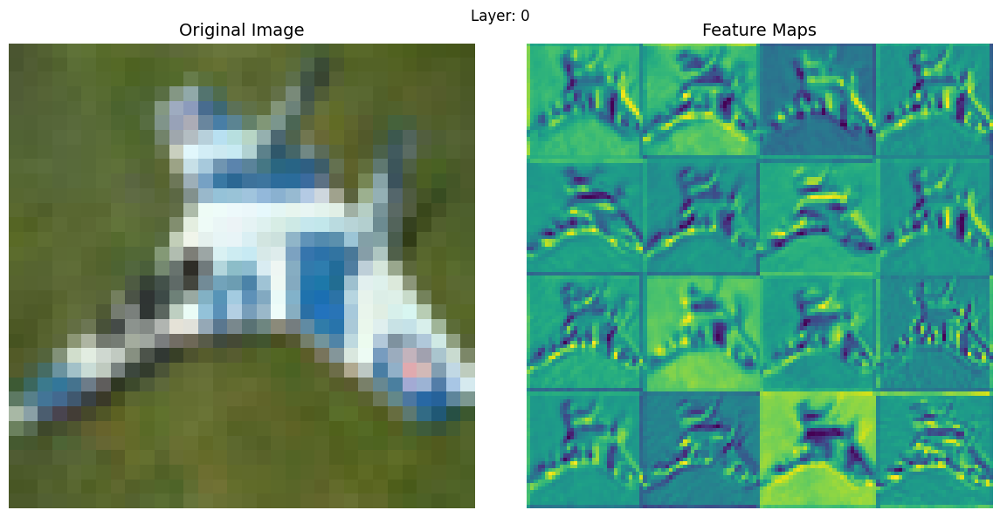

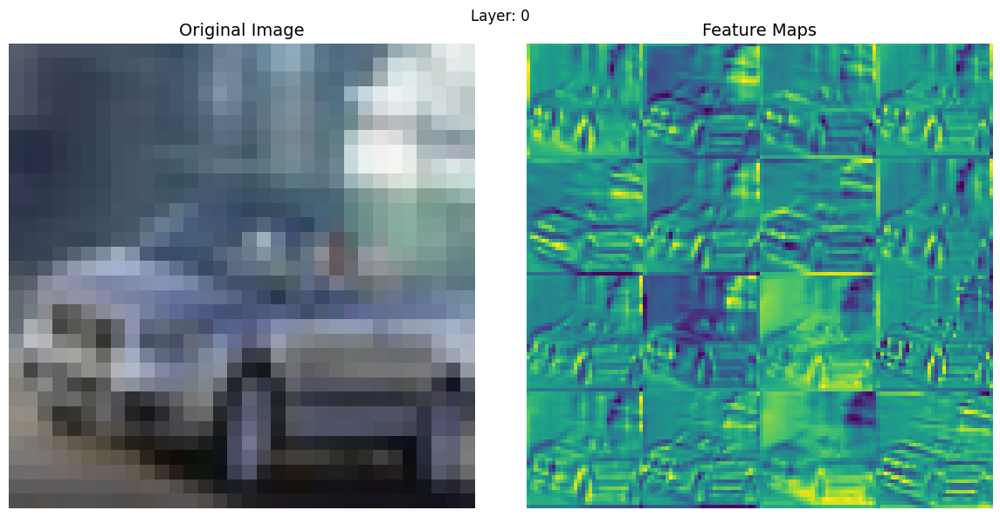

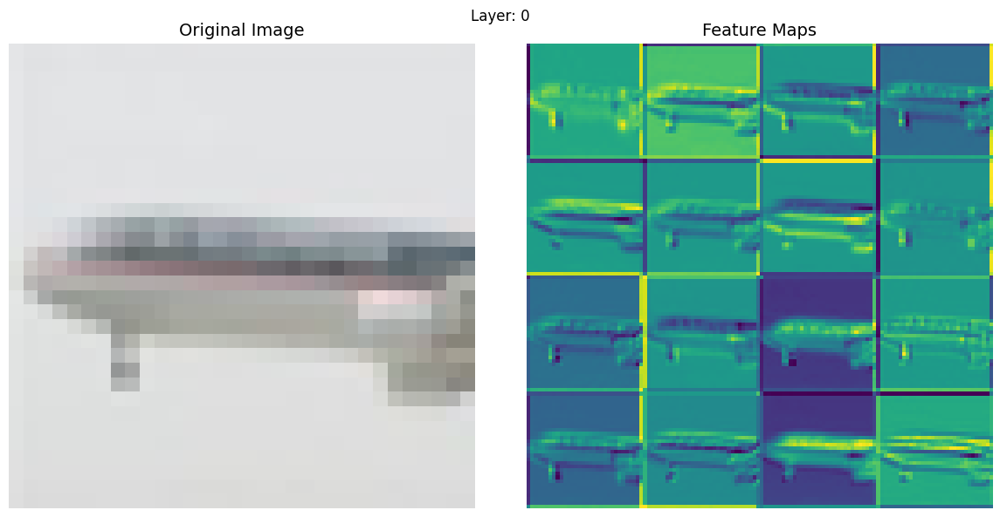

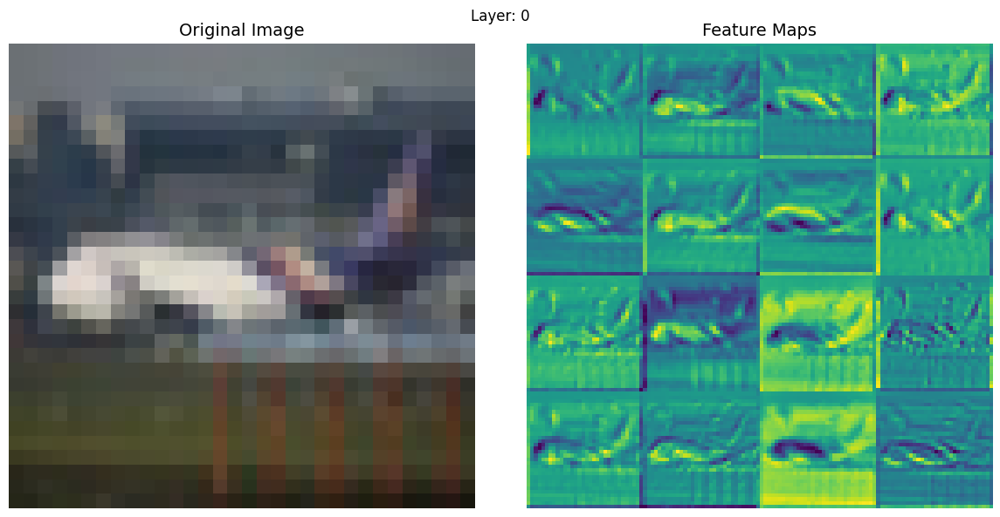

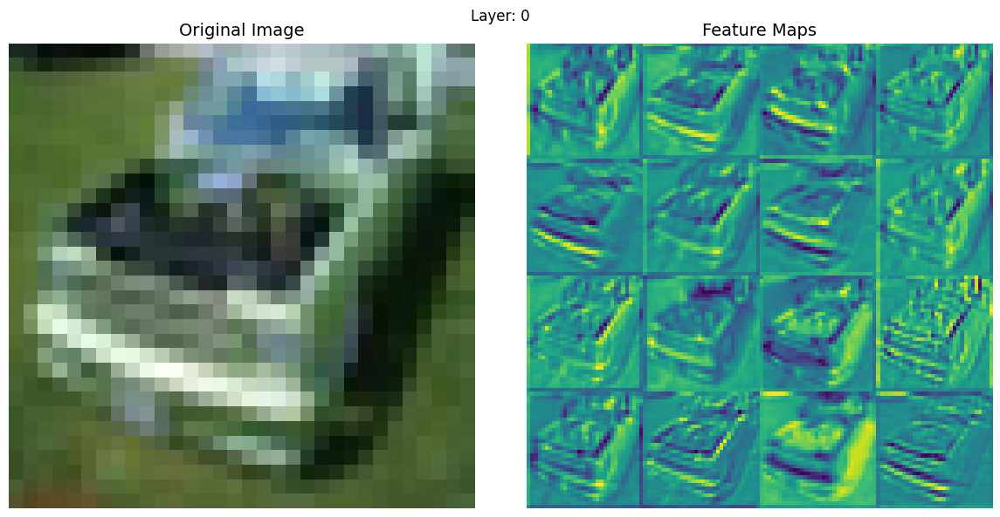

...

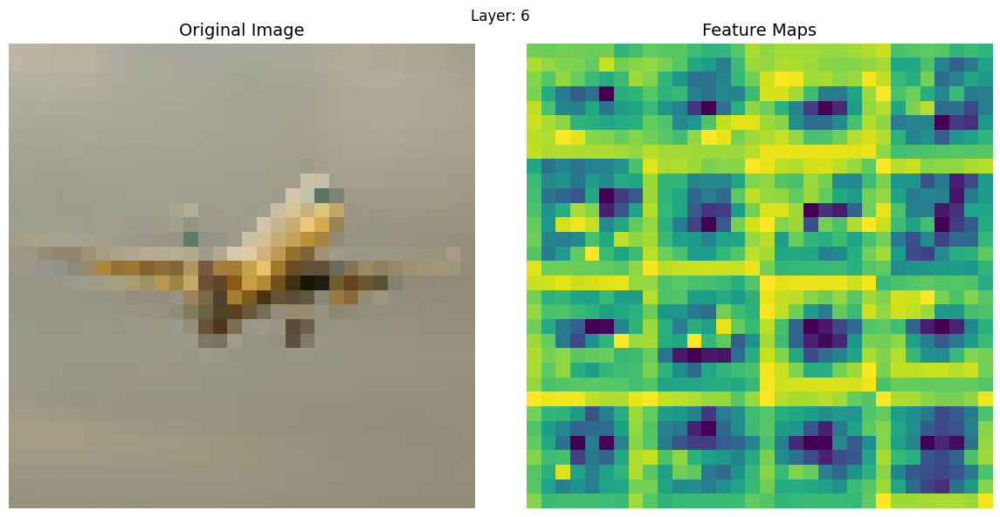

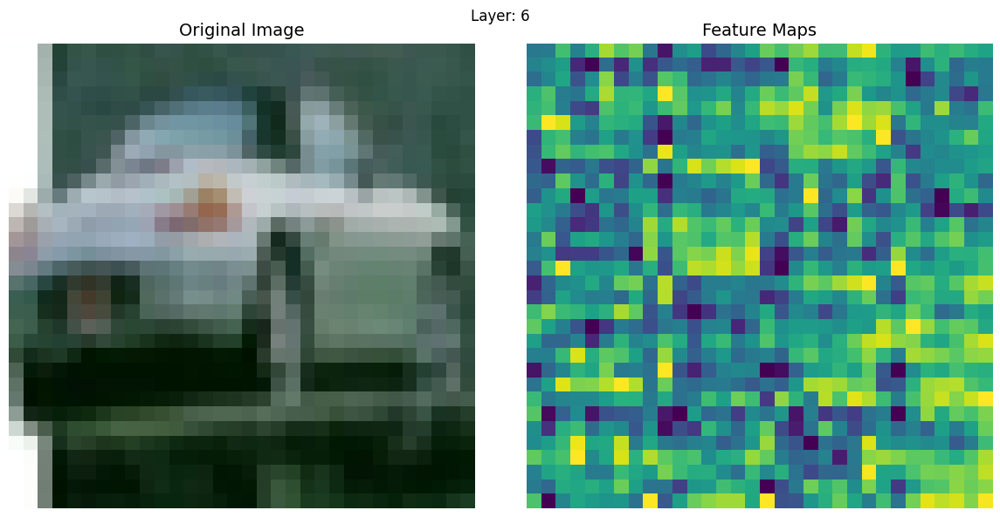

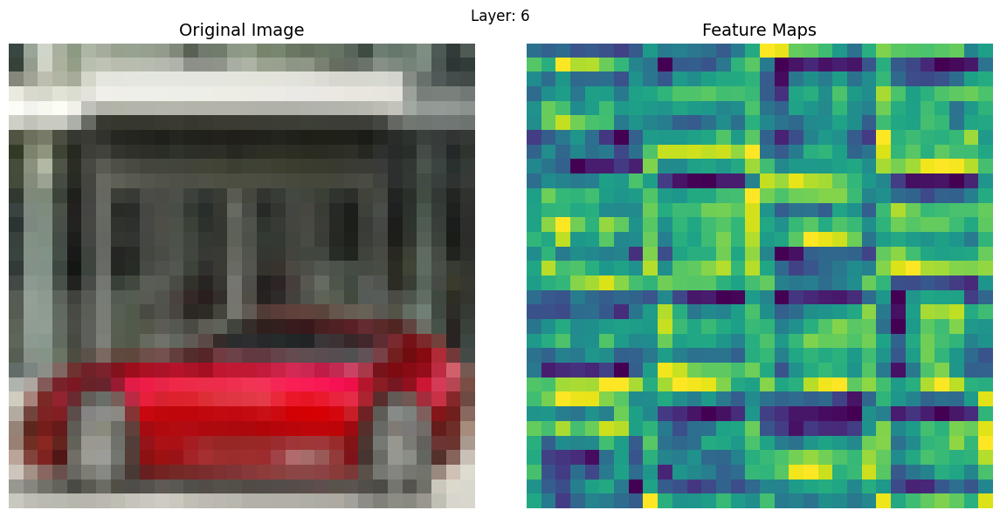

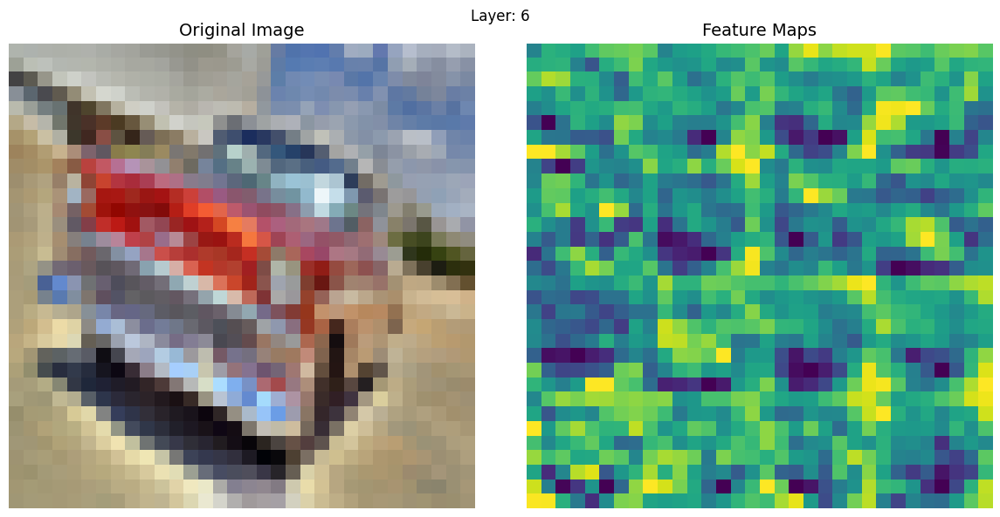

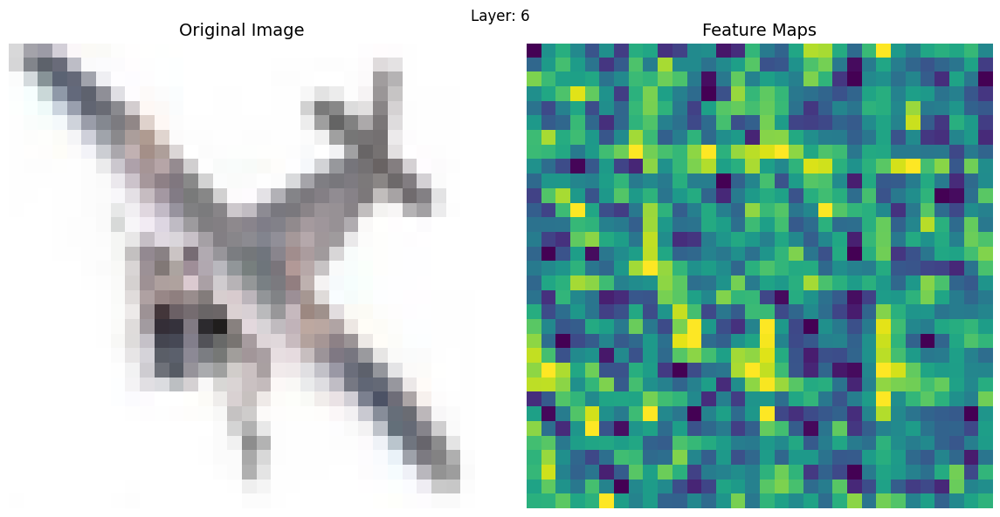

Epoch 10/10, Loss: 0.0160, Accuracy: 99.31%


In [35]:
num_classes = 2
model = CustomCNN(num_classes=num_classes).to(device)
layer_names = ['0','3','6']

cross_entropy_loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
train_acc, train_loss = [],[]
print(f'Feature maps before training')
for layer_name in layer_names:
    visualize_feature_maps(model, train_loader, layer_name, device)

print('Training:')
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    for i, (anchor, _, _, labels) in enumerate(train_loader, 0):
        anchor, labels = anchor.to(device), labels.to(device)

        optimizer.zero_grad()

        # Forward pass
        logits = model(anchor)

        # Compute cross-entropy loss
        cross_entropy_loss = cross_entropy_loss_fn(logits, labels)
        cross_entropy_loss.backward()
        optimizer.step()

        # Update loss
        running_loss += cross_entropy_loss.item()

        # Accuracy computation
        _, predicted = logits.max(1)
        correct += predicted.eq(labels).sum().item()
        total += labels.size(0)

    accuracy = 100 * correct / total
    avg_loss = running_loss / (i + 1)
    train_acc.append(accuracy)
    train_loss.append(avg_loss)

    if epoch%5==0 or epoch+1 ==num_epochs:
        print(f'Feature maps for epoch {epoch+1}')
        for layer_name in layer_names:
            visualize_feature_maps(model, train_loader, layer_name, device)

    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%")


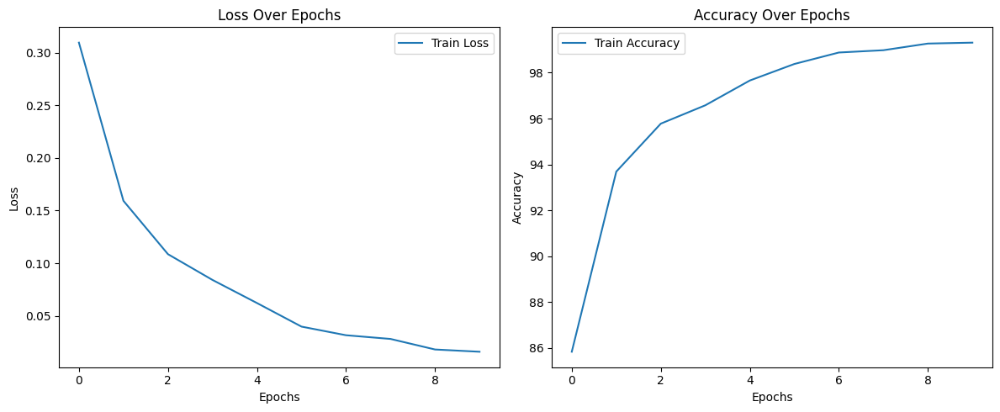

In [36]:
# Plot training and validation loss
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_loss, label="Train Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Loss Over Epochs")
plt.legend()

# Plot training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(train_acc, label="Train Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Accuracy Over Epochs")
plt.legend()

plt.tight_layout()
plt.show()

In [37]:
model.eval()
running_loss = 0.0
correct = 0
total = 0

with torch.no_grad():
    for i, (anchor, _, _, labels) in enumerate(test_loader, 0):
        anchor, labels = anchor.to(device), labels.to(device)

        # Forward pass
        logits = model(anchor)

        # Compute cross-entropy loss
        cross_entropy_loss = cross_entropy_loss_fn(logits, labels)

        # Update loss
        running_loss += cross_entropy_loss.item()

        # Accuracy computation
        _, predicted = logits.max(1)
        correct += predicted.eq(labels).sum().item()
        total += labels.size(0)

    accuracy = 100 * correct / total
    avg_loss = running_loss / (i + 1)
    print(f"Test Loss: {avg_loss:.4f},Test Accuracy: {accuracy:.2f}%")

Test Loss: 0.1731,Test Accuracy: 95.90%


Feature maps before training


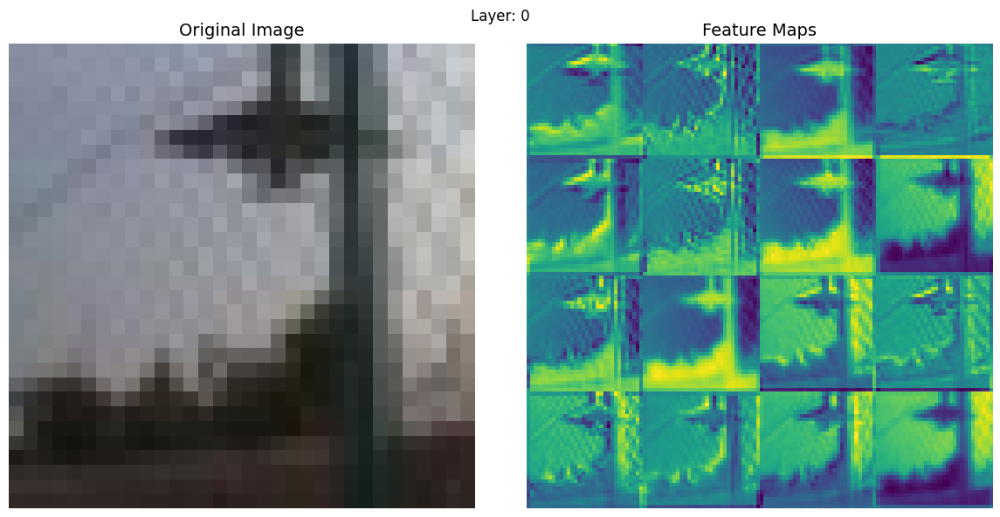

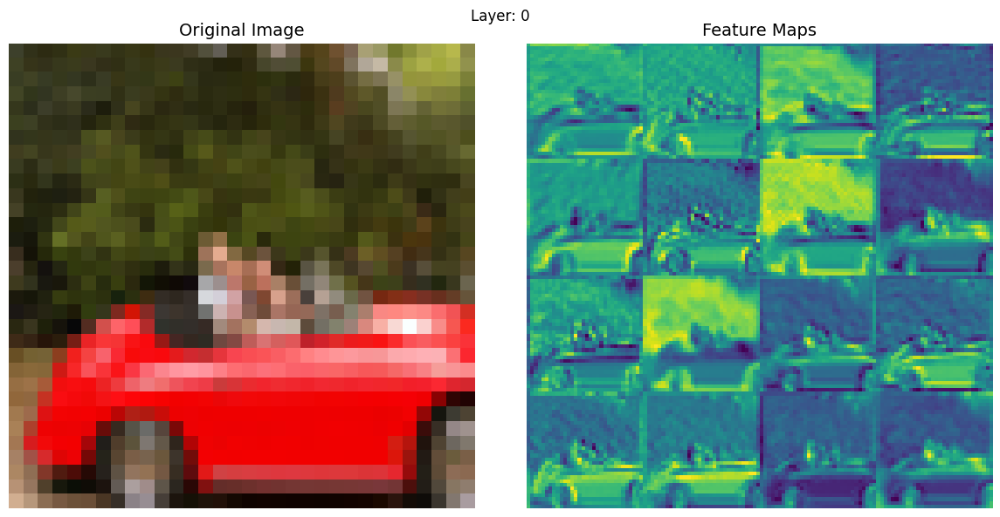

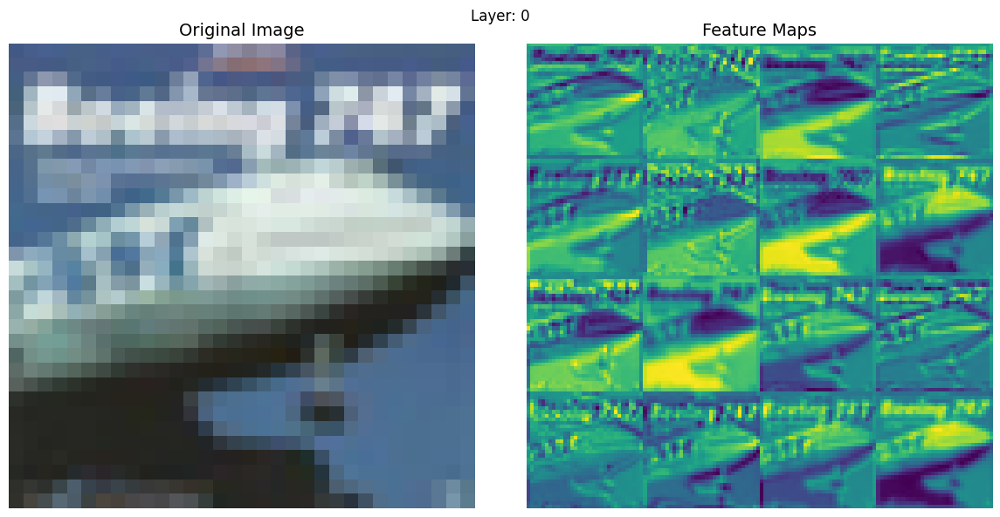

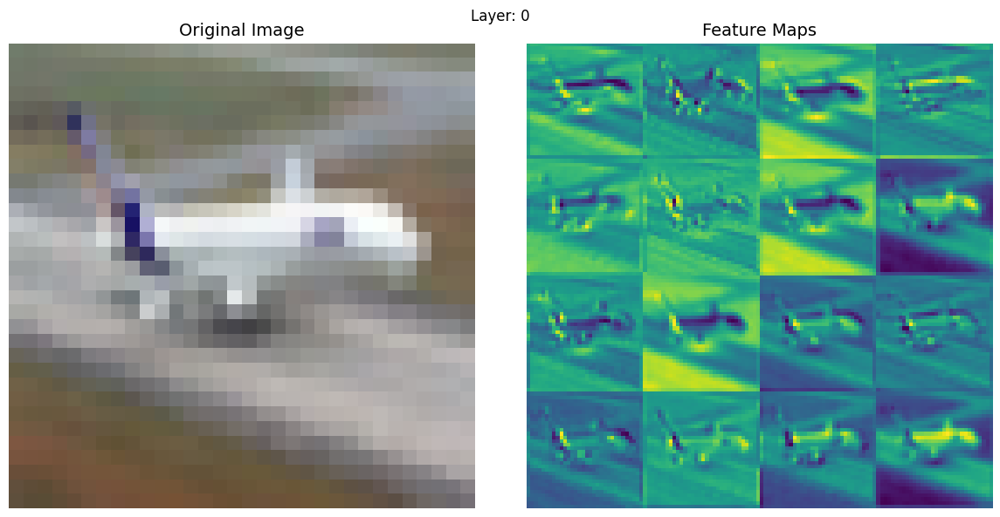

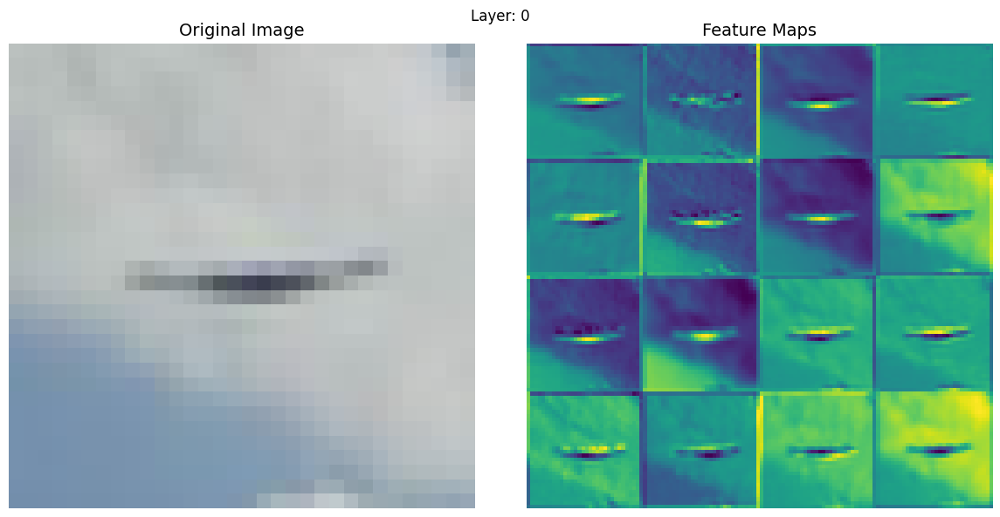

...

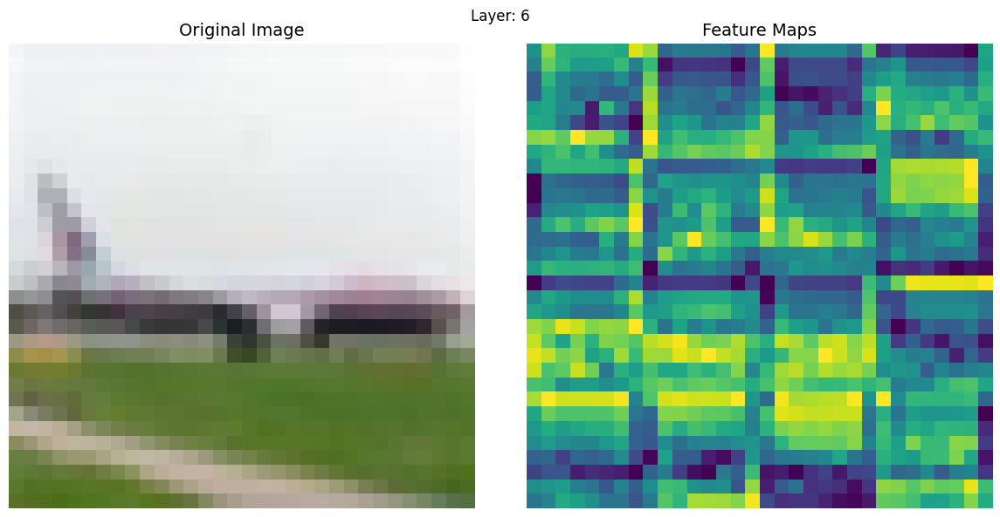

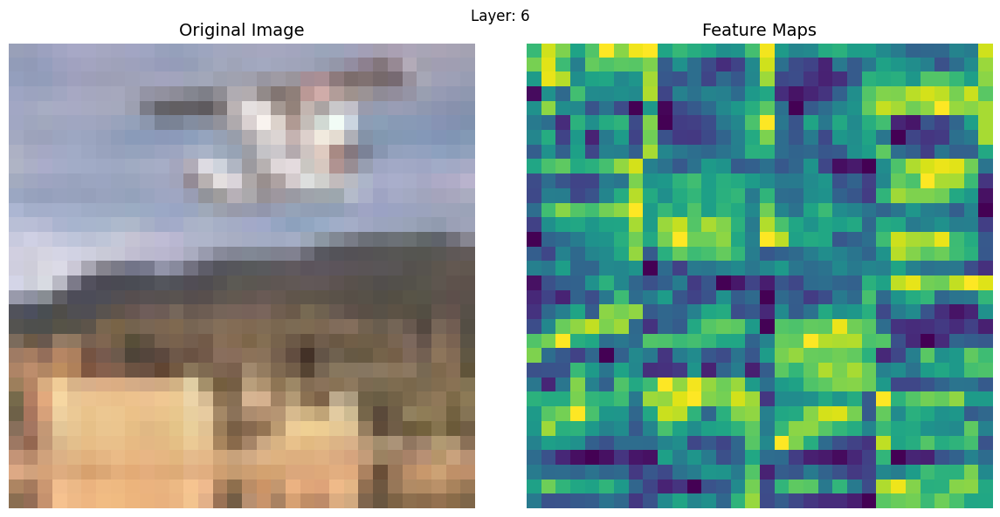

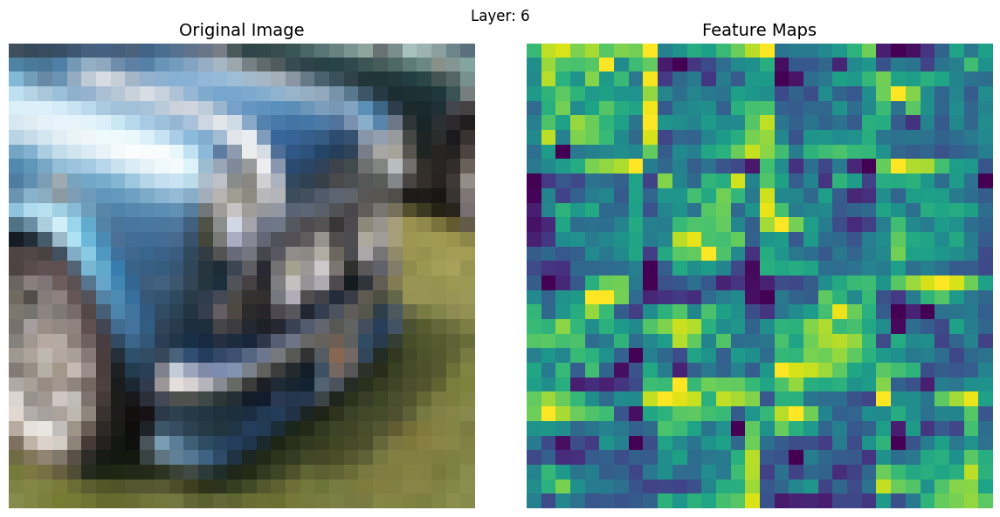

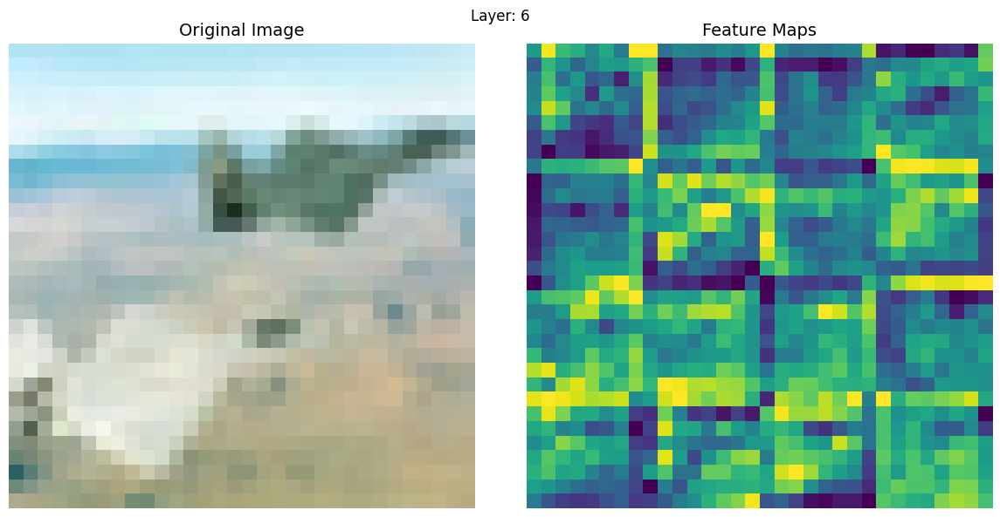

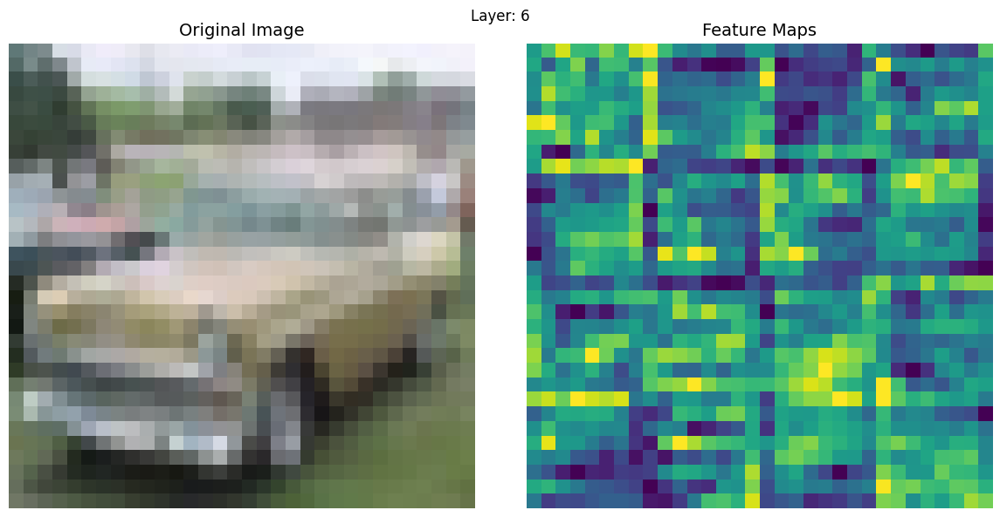

Training convolutional layers with Triplet Loss...
Feature maps for epoch 1


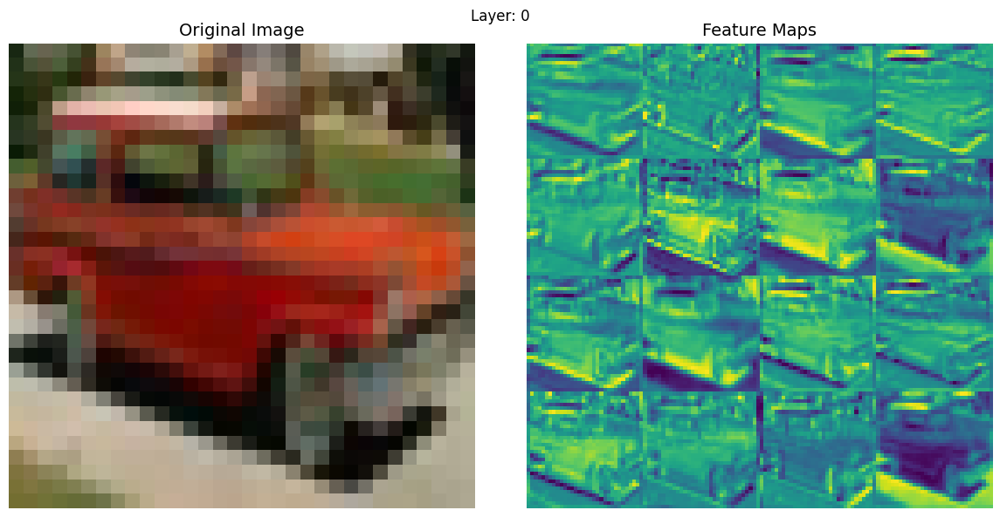

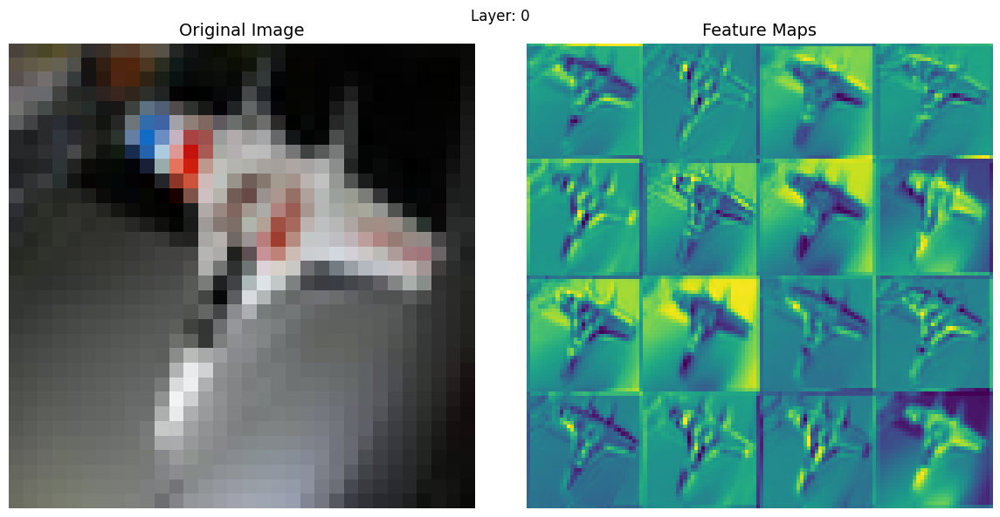

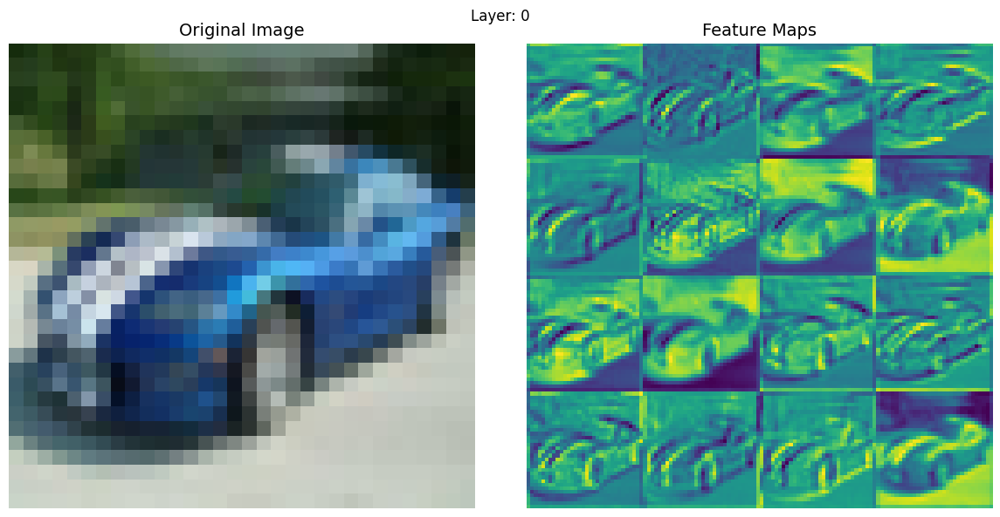

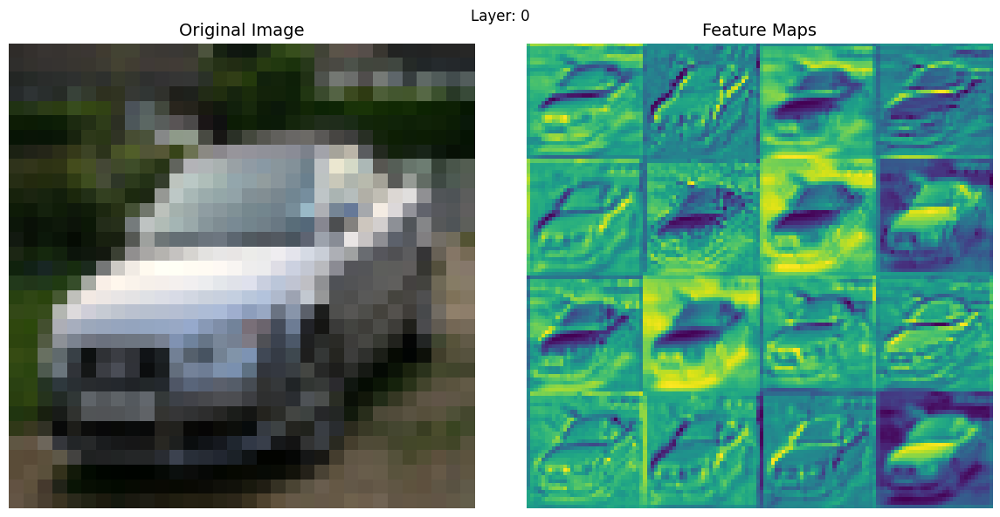

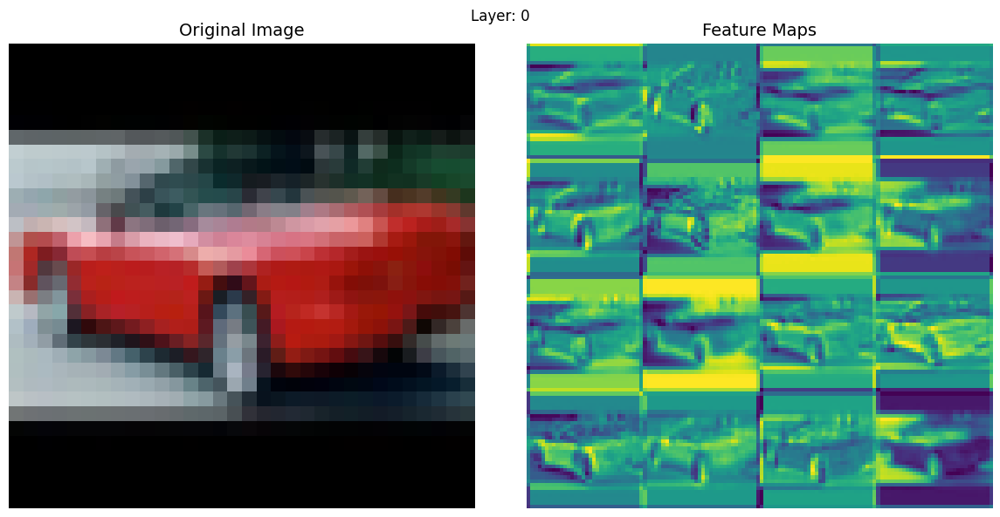

...

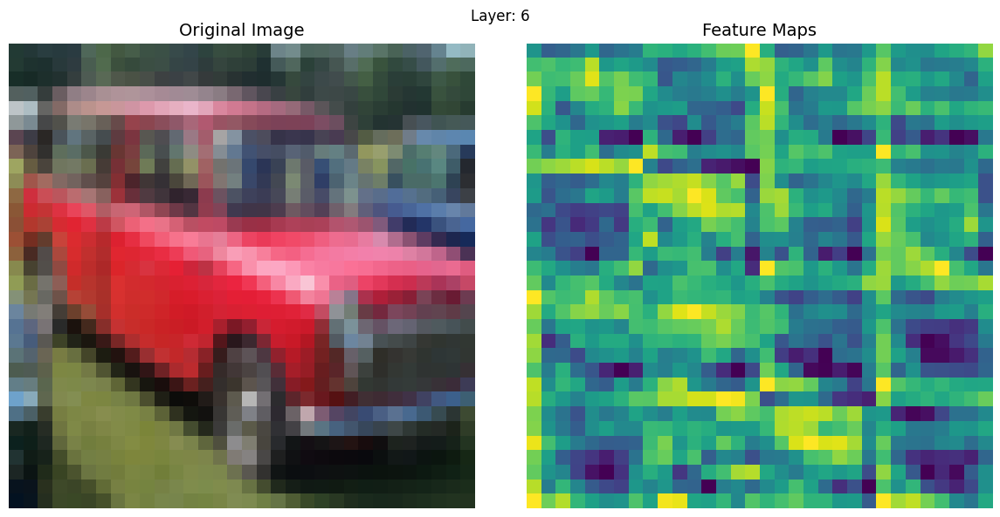

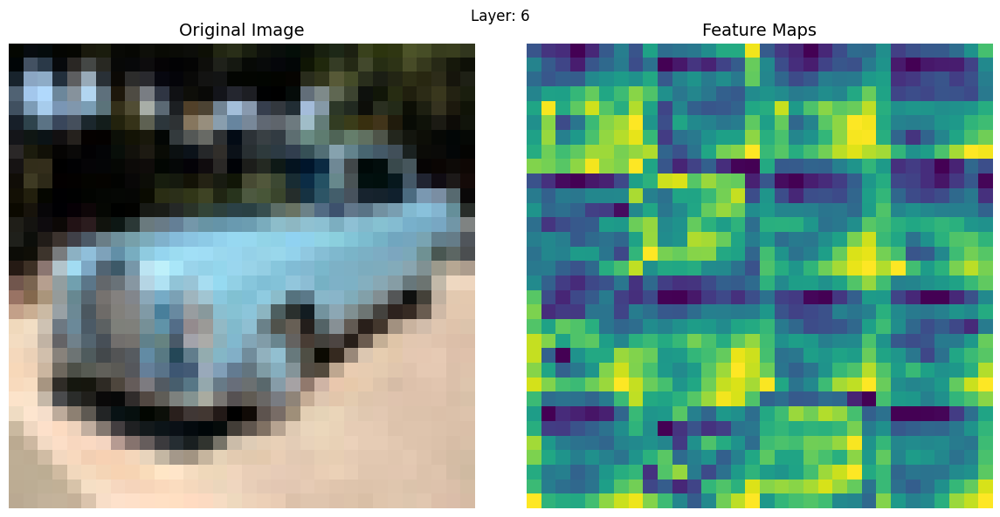

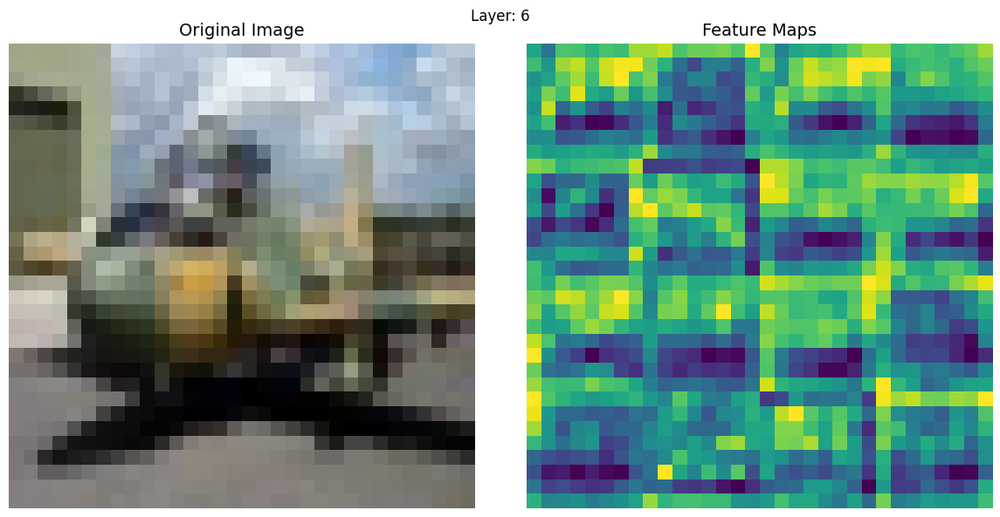

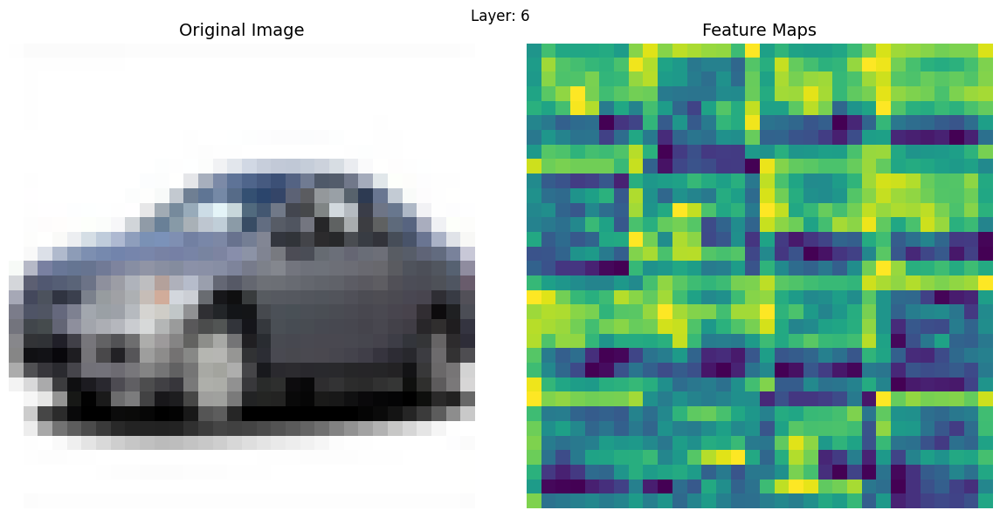

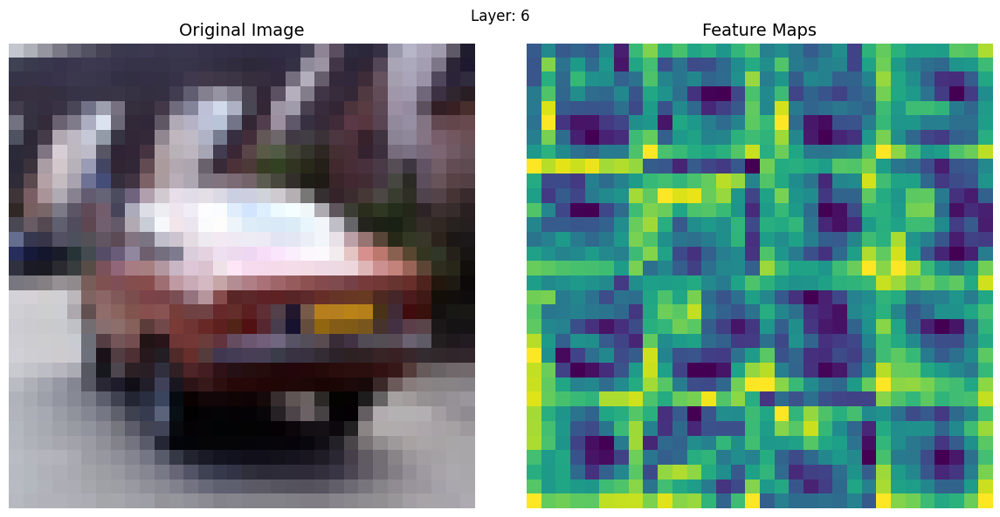

Epoch 1/10, Loss: 0.5349, Accuracy: 46.12%
Epoch 2/10, Loss: 0.4268, Accuracy: 56.68%
Epoch 3/10, Loss: 0.3581, Accuracy: 63.17%
Epoch 4/10, Loss: 0.3271, Accuracy: 66.21%
Epoch 5/10, Loss: 0.2895, Accuracy: 69.15%
Feature maps for epoch 6


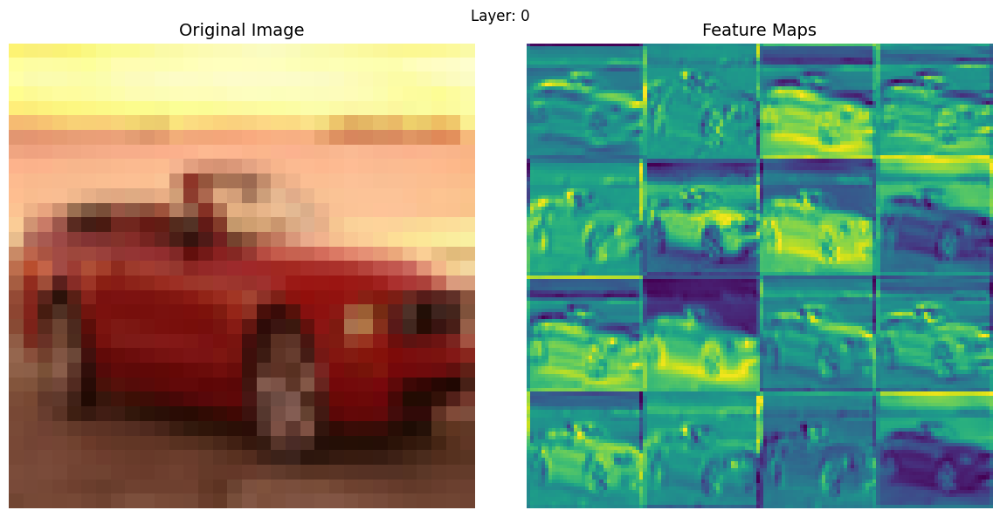

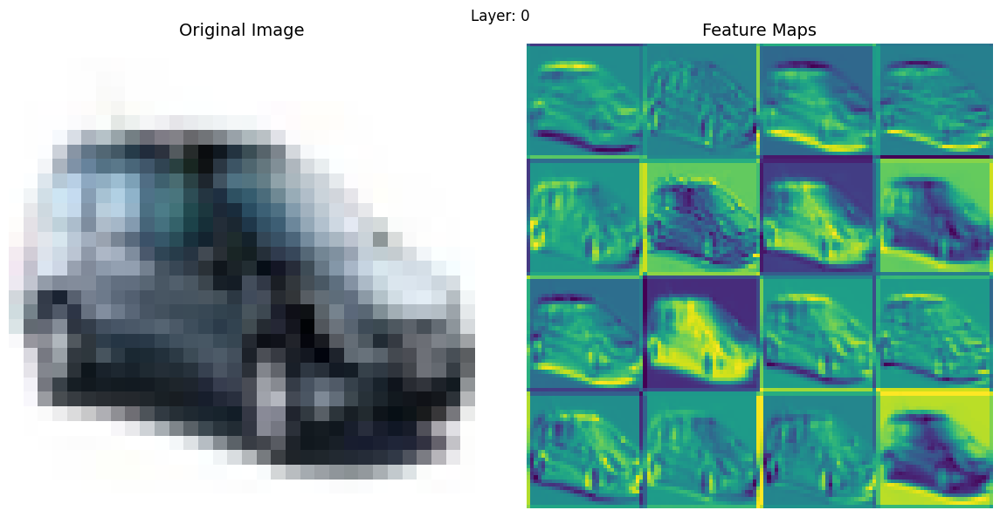

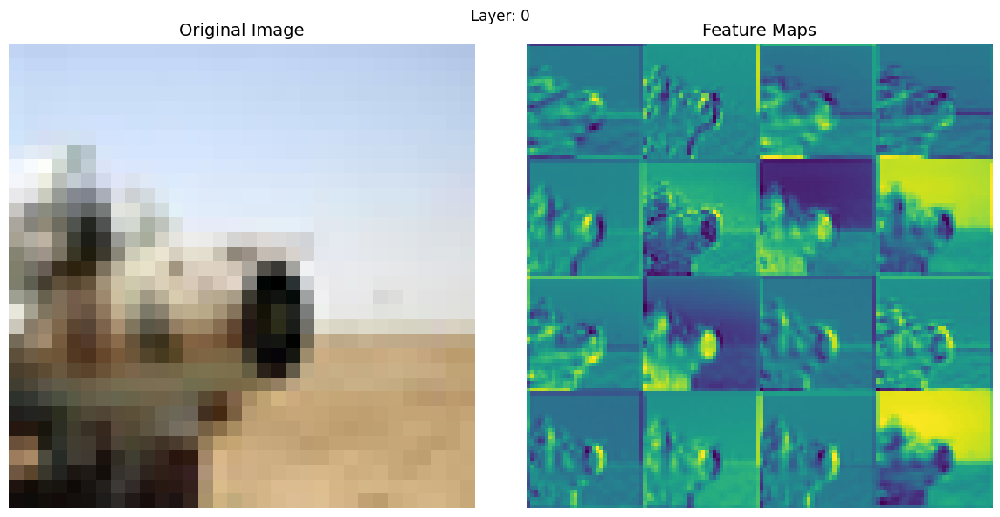

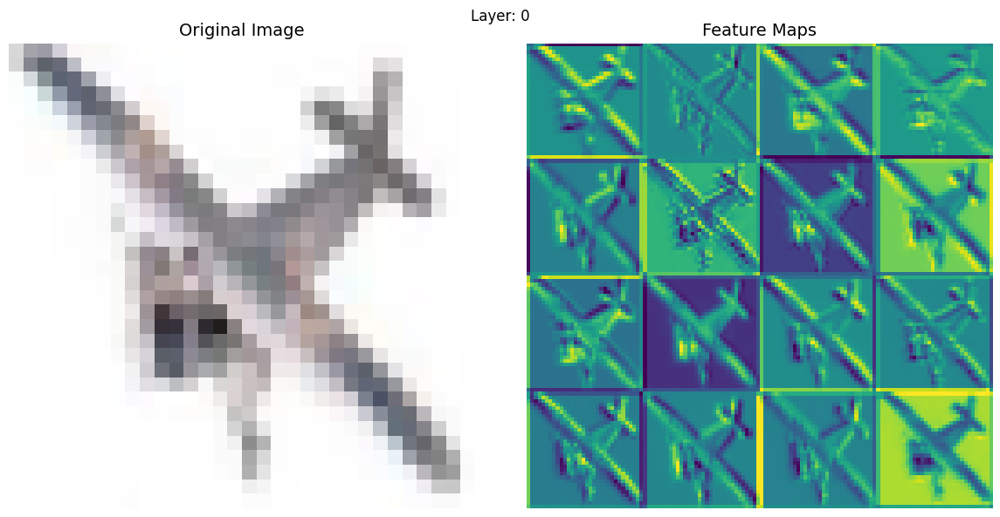

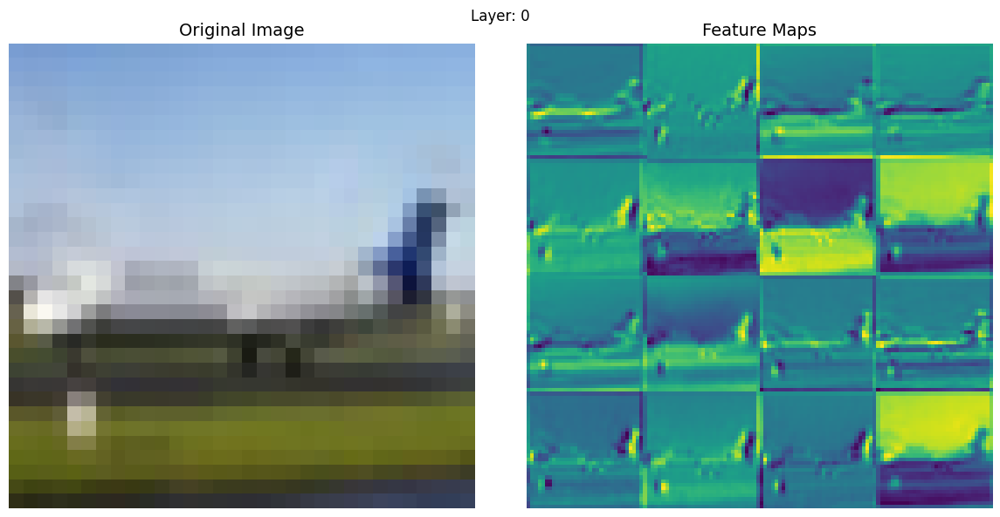

...

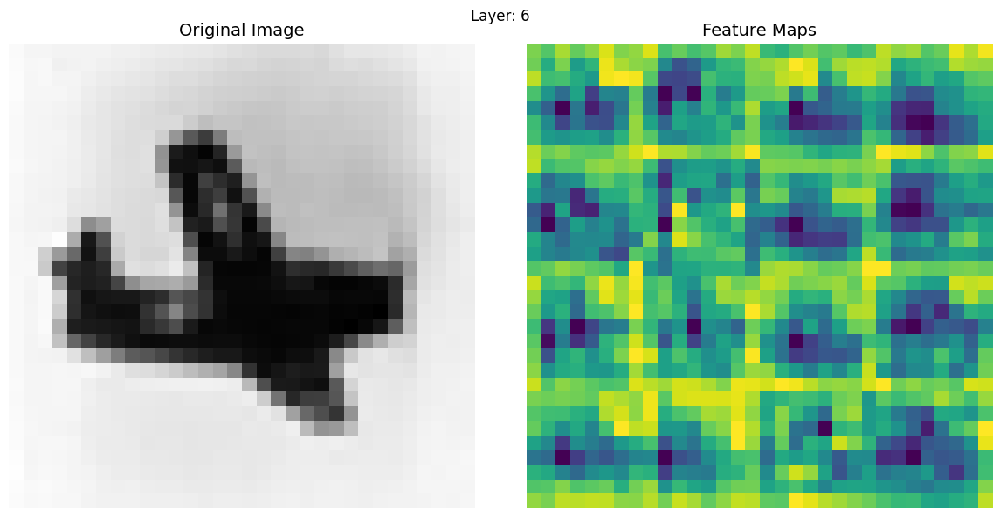

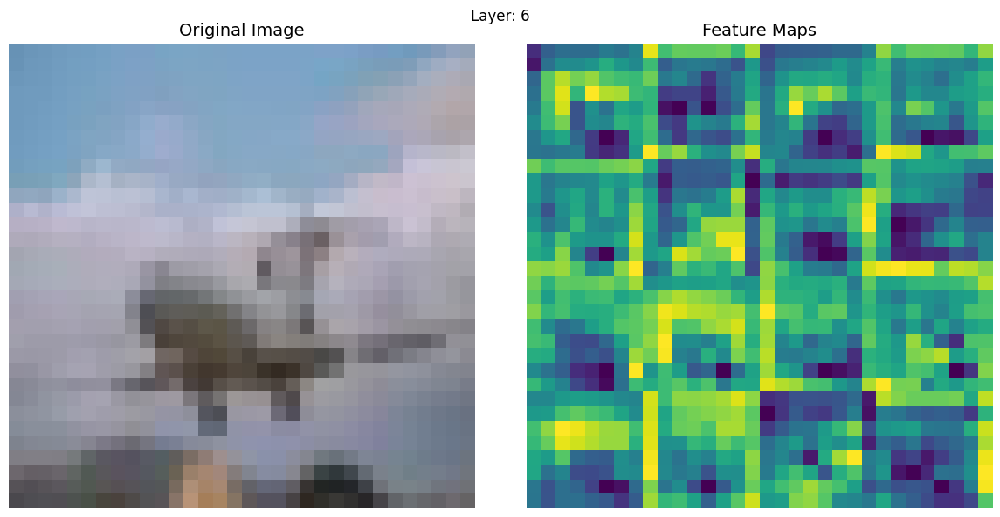

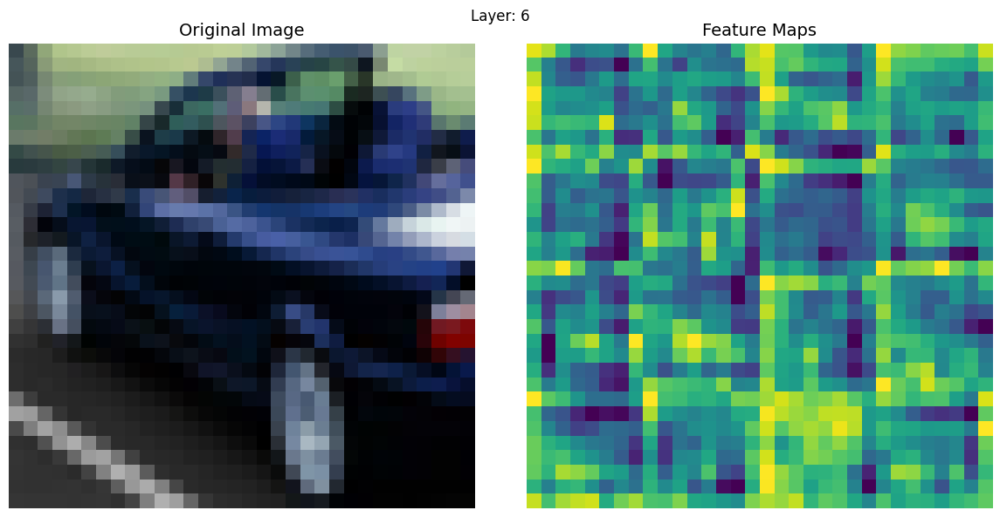

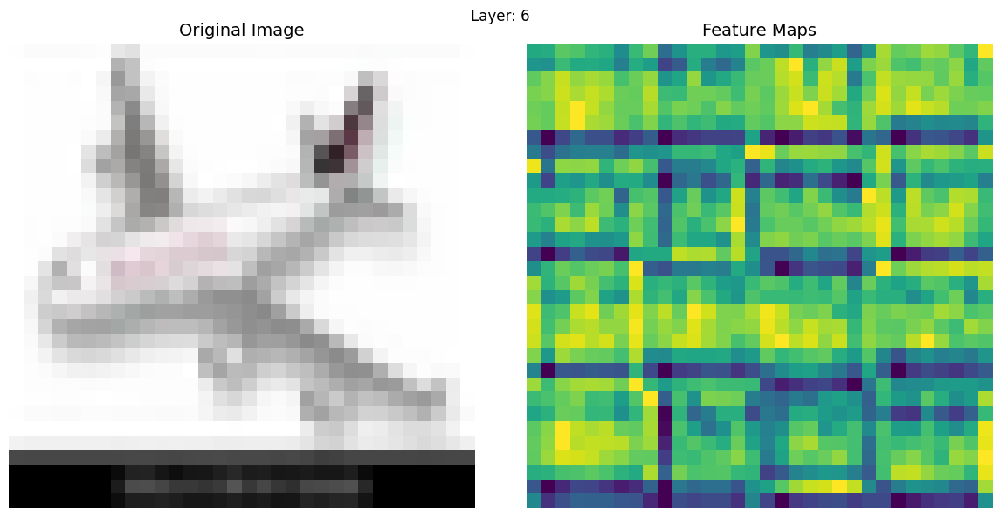

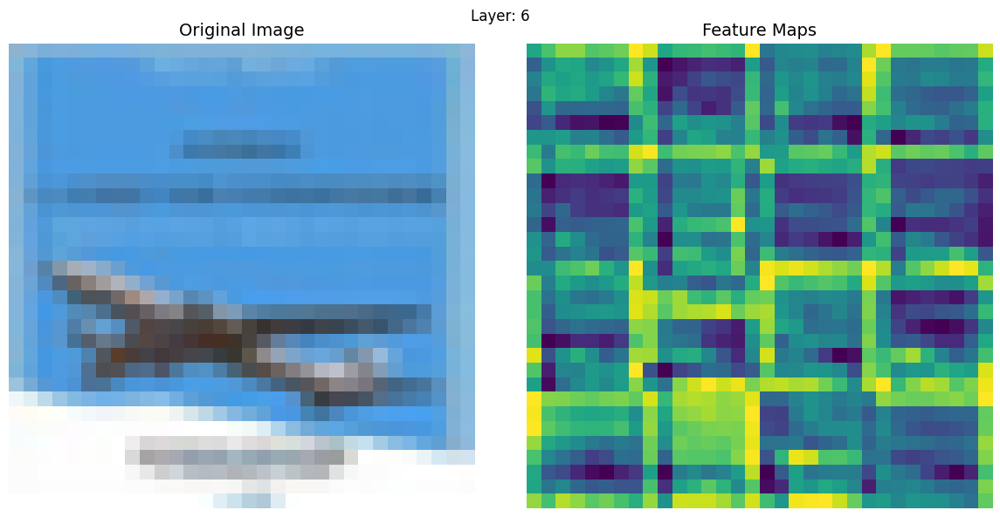

Epoch 6/10, Loss: 0.2721, Accuracy: 71.41%
Epoch 7/10, Loss: 0.2586, Accuracy: 72.91%
Epoch 8/10, Loss: 0.2481, Accuracy: 73.75%
Epoch 9/10, Loss: 0.2324, Accuracy: 75.89%
Feature maps for epoch 10


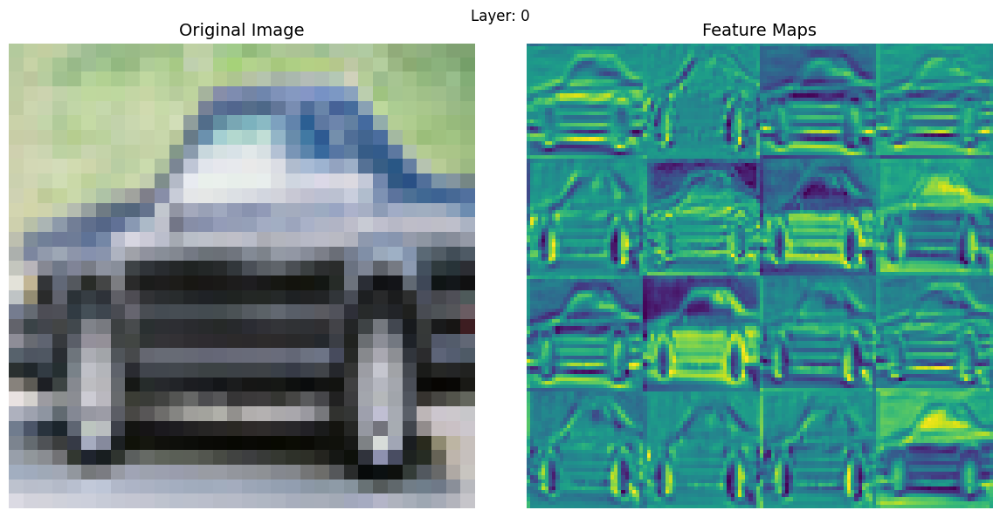

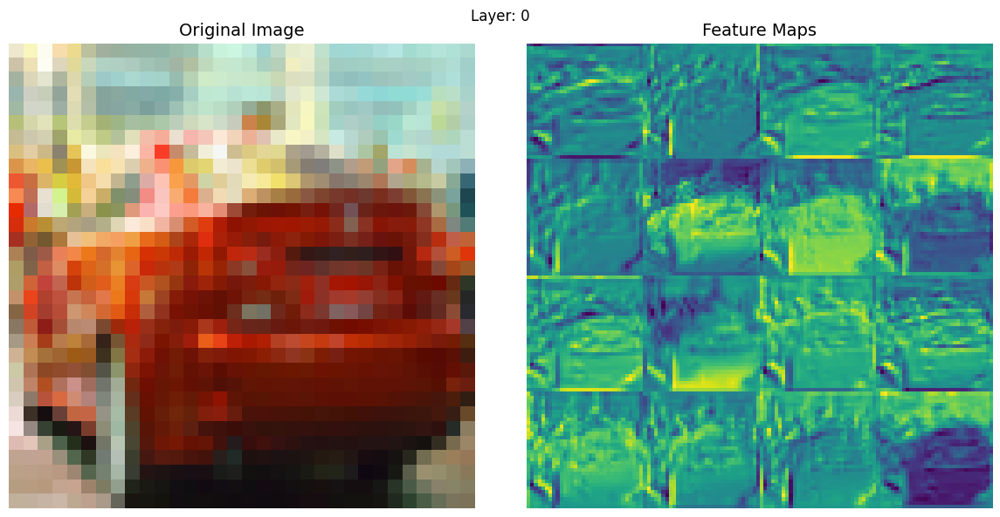

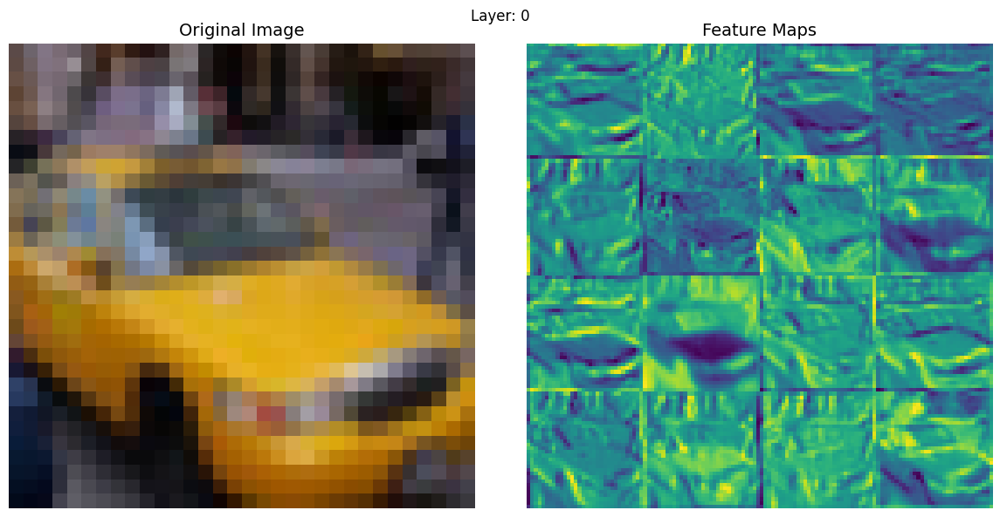

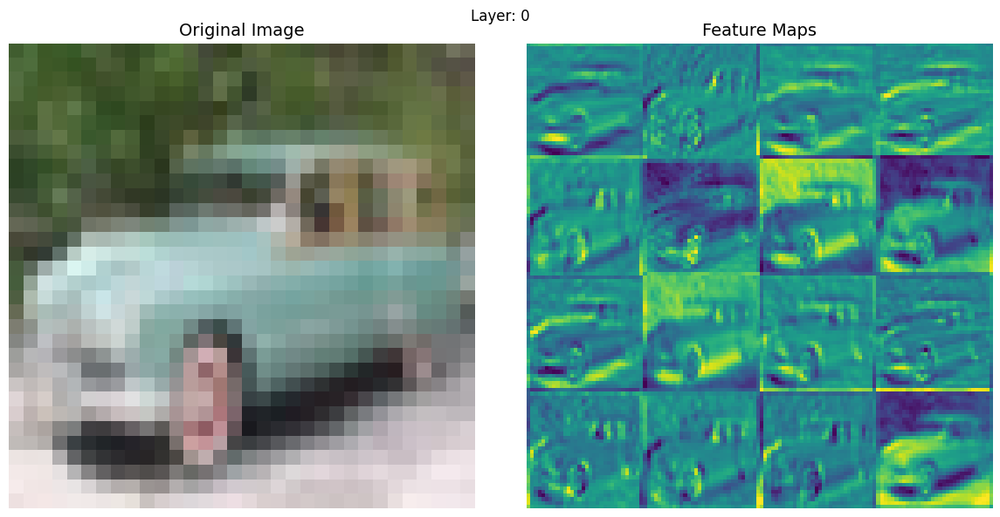

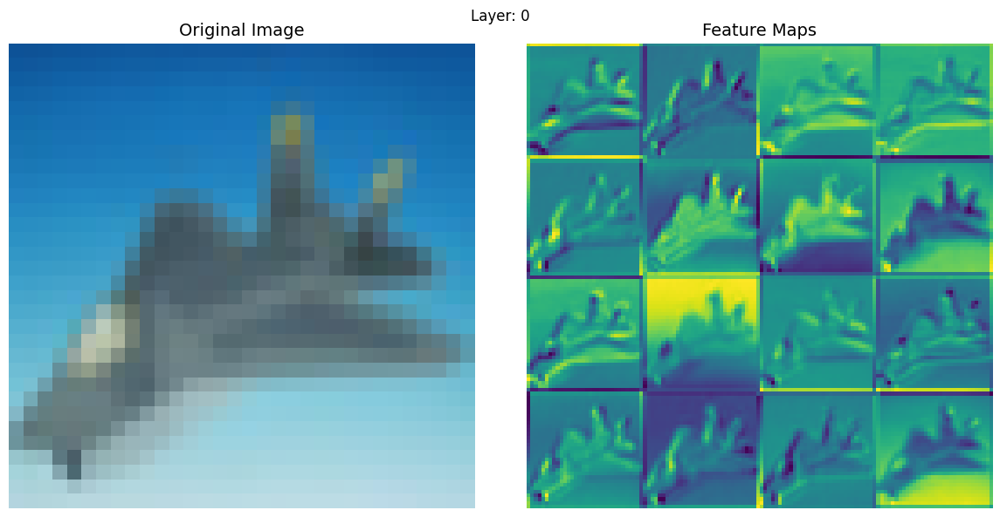

...

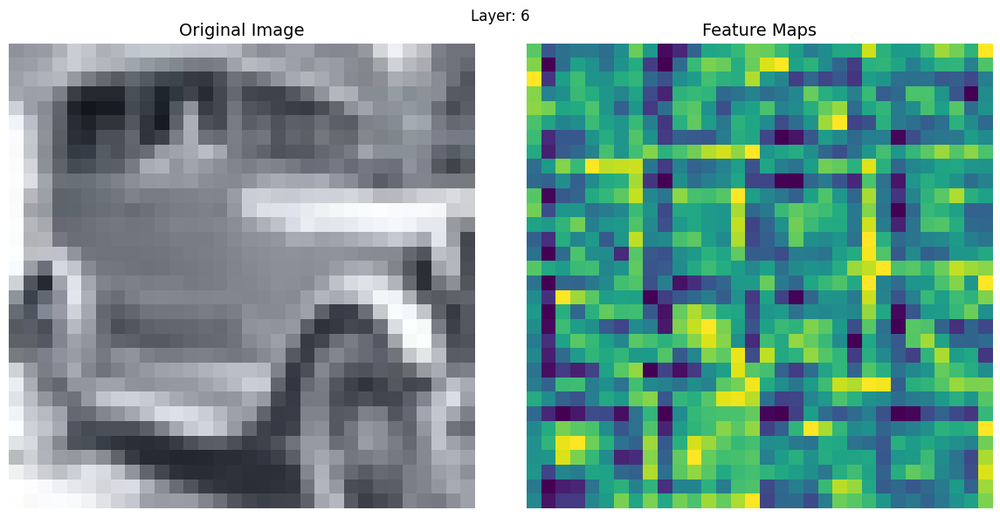

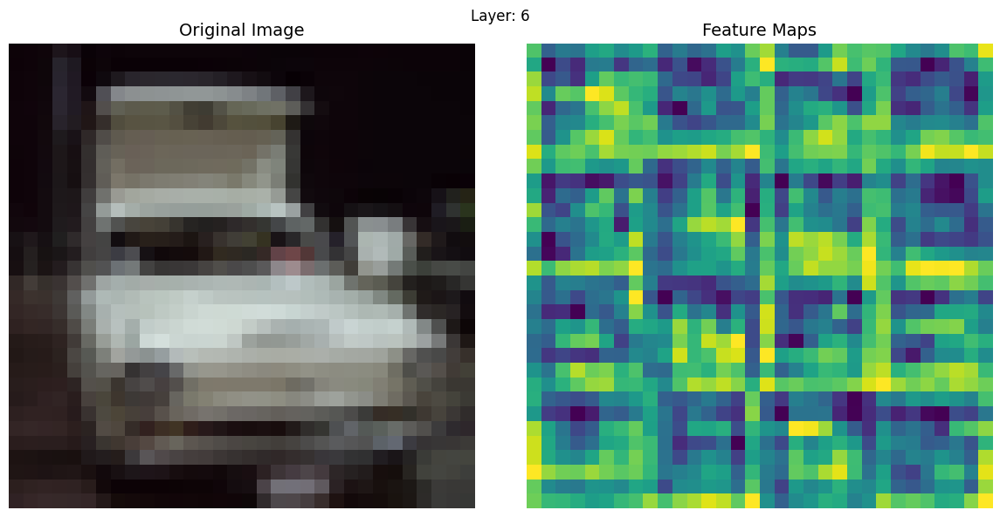

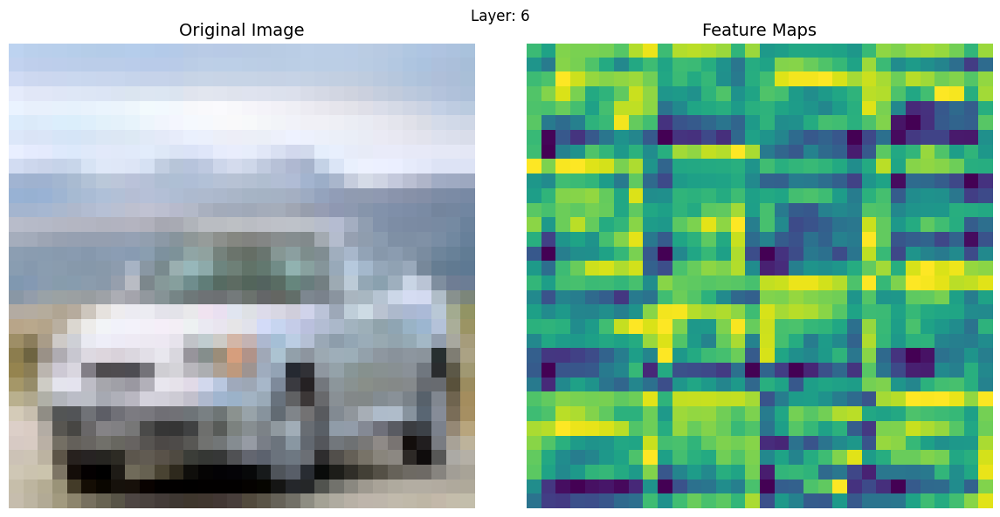

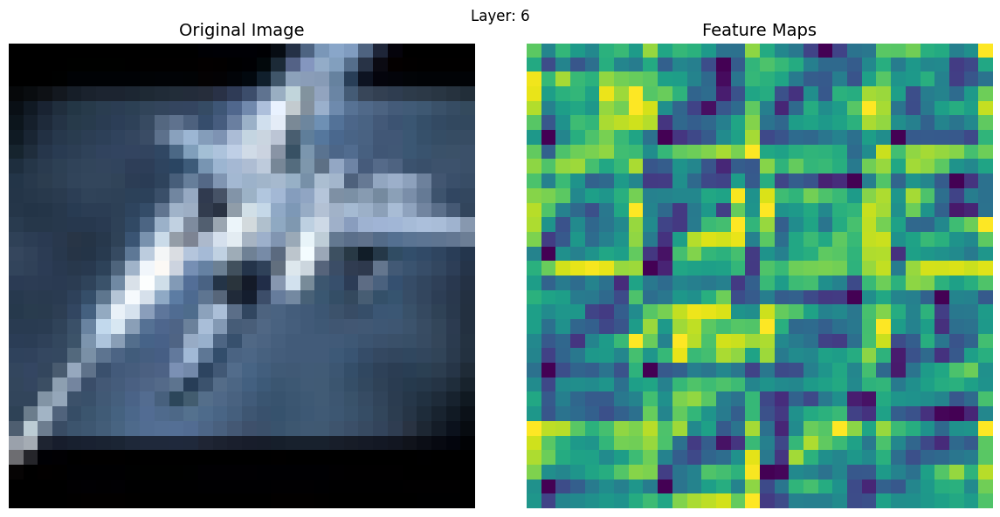

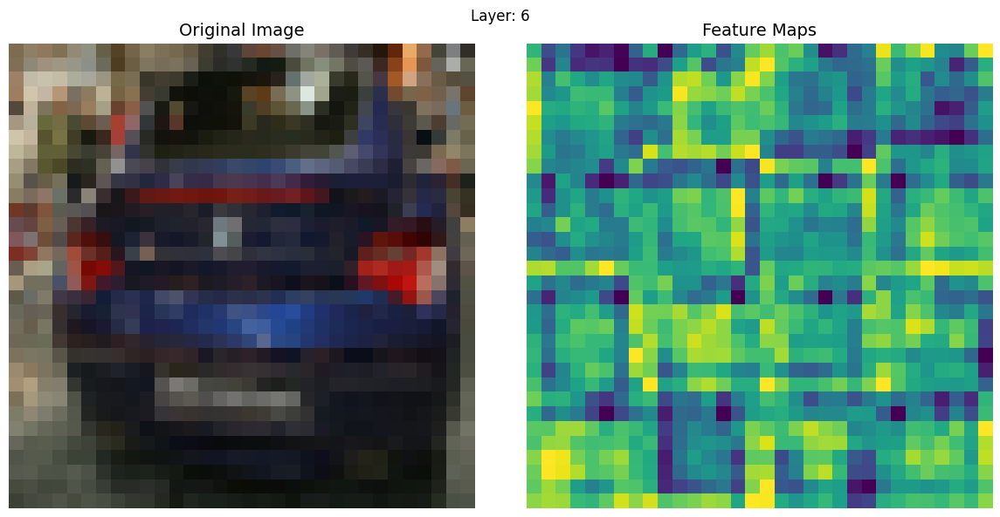

Epoch 10/10, Loss: 0.2050, Accuracy: 77.98%
Training classifier layer with Cross Entropy Loss...
Epoch 1/10, Loss: 0.2002, Accuracy: 92.19%
Epoch 2/10, Loss: 0.1473, Accuracy: 94.19%
Epoch 3/10, Loss: 0.1319, Accuracy: 94.82%
Epoch 4/10, Loss: 0.1160, Accuracy: 95.59%
Epoch 5/10, Loss: 0.1001, Accuracy: 96.28%
Epoch 6/10, Loss: 0.0857, Accuracy: 96.83%
Epoch 7/10, Loss: 0.0713, Accuracy: 97.45%
Epoch 8/10, Loss: 0.0535, Accuracy: 98.08%
Epoch 9/10, Loss: 0.0410, Accuracy: 98.60%
Epoch 10/10, Loss: 0.0308, Accuracy: 99.09%


In [38]:
model = CustomCNN(num_classes=num_classes).to(device)
layer_names = ['0','3','6']

triplet_loss_fn = nn.TripletMarginLoss(margin=1.0)

tri_train_acc, cross_train_acc, tri_train_loss, cross_train_loss = [],[],[],[]

# Step 1: Train convolutional layers
for param in model.fc.parameters():
    param.requires_grad = False

optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.001)
num_epochs = 10

print(f'Feature maps before training')
for layer_name in layer_names:
    visualize_feature_maps(model, train_loader, layer_name, device)

print("Training convolutional layers with Triplet Loss...")
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total =0
    for i, (anchor, positive, negative, _) in enumerate(train_loader, 0):
        anchor, positive, negative = anchor.to(device), positive.to(device), negative.to(device)

        optimizer.zero_grad()

        # Forward pass
        anchor_out = model.features(anchor)
        positive_out = model.features(positive)
        negative_out = model.features(negative)

        # Compute Triplet Loss
        loss = triplet_loss_fn(anchor_out.view(anchor_out.size(0), -1), 
                               positive_out.view(positive_out.size(0), -1), 
                               negative_out.view(negative_out.size(0), -1))
        loss.backward()
        optimizer.step()

        # Update loss
        running_loss += loss.item()

        # Compute pairwise distances
        d_ap = pairwise_distance(anchor_out.view(anchor_out.size(0), -1), 
                                 positive_out.view(positive_out.size(0), -1))
        d_an = pairwise_distance(anchor_out.view(anchor_out.size(0), -1), 
                                 negative_out.view(negative_out.size(0), -1))

        # Check triplet condition
        correct += torch.sum(d_ap + 1.0 < d_an).item()  # Margin is 1.0
        total += anchor.size(0)

    accuracy = 100 * correct / total
    avg_loss = running_loss / (i + 1)
    tri_train_acc.append(accuracy)
    tri_train_loss.append(avg_loss)

    if epoch%5==0 or epoch+1 ==num_epochs:
        print(f'Feature maps for epoch {epoch+1}')
        for layer_name in layer_names:
            visualize_feature_maps(model, train_loader, layer_name, device)
    
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%")
    
# Step 2: Freeze convolutional layers and train classifier
for param in model.features.parameters():
    param.requires_grad = False
for param in model.fc.parameters():
    param.requires_grad = True


cross_entropy_loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.fc.parameters(), lr=0.001)
num_epochs = 10

print("Training classifier layer with Cross Entropy Loss...")
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    for i, (anchor, _, _, labels) in enumerate(train_loader, 0):
        anchor, labels = anchor.to(device), labels.to(device)

        optimizer.zero_grad()

        # Forward pass
        logits = model(anchor)

        # Compute cross-entropy loss
        cross_entropy_loss = cross_entropy_loss_fn(logits, labels)
        cross_entropy_loss.backward()
        optimizer.step()

        # Update loss
        running_loss += cross_entropy_loss.item()

        # Accuracy computation
        _, predicted = logits.max(1)
        correct += predicted.eq(labels).sum().item()
        total += labels.size(0)

    accuracy = 100 * correct / total
    avg_loss = running_loss / (i + 1)
    cross_train_acc.append(accuracy)
    cross_train_loss.append(avg_loss)
    
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%")

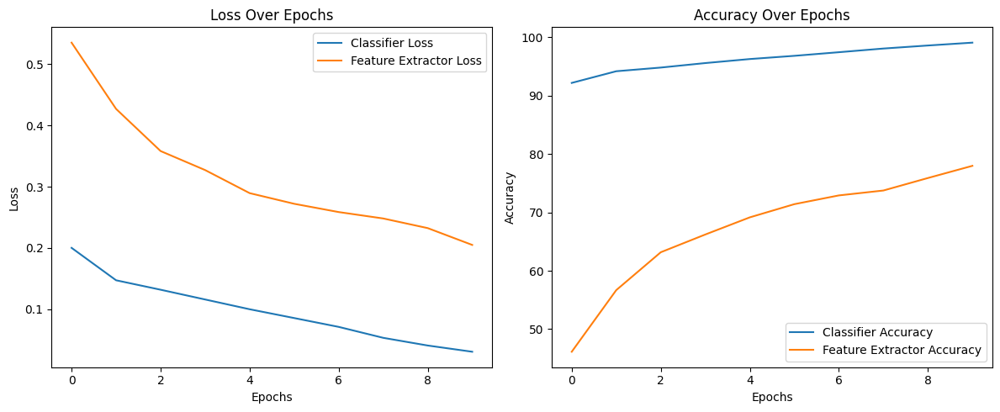

In [39]:
# Plot training and validation loss
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(cross_train_loss, label="Classifier Loss")
plt.plot(tri_train_loss, label="Feature Extractor Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Loss Over Epochs")
plt.legend()

# Plot training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(cross_train_acc, label="Classifier Accuracy")
plt.plot(tri_train_acc, label="Feature Extractor Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Accuracy Over Epochs")
plt.legend()

plt.tight_layout()
plt.show()

In [40]:
model.eval()
running_loss = 0.0
correct = 0
total = 0
with torch.no_grad():
    for i, (anchor, _, _, labels) in enumerate(test_loader, 0):
        anchor, labels = anchor.to(device), labels.to(device)

        # Forward pass
        logits = model(anchor)

        # Compute cross-entropy loss
        cross_entropy_loss = cross_entropy_loss_fn(logits, labels)

        # Update loss
        running_loss += cross_entropy_loss.item()

        # Accuracy computation
        _, predicted = logits.max(1)
        correct += predicted.eq(labels).sum().item()
        total += labels.size(0)


    accuracy = 100 * correct / total
    avg_loss = running_loss / (i + 1)
    
    print(f"Test Loss: {avg_loss:.4f}, Test Accuracy: {accuracy:.2f}%")

Test Loss: 0.2187, Test Accuracy: 93.95%


In Triplet loss trained model, the resulting feature maps exhibit clearer separability in latent space, which aids downstream tasks like classification and retrieval.


# Part III

### **a) Quality of Feature Maps in Different Layers**

#### **Cross-Entropy Loss**
- **Nature**: Supervises training by associating specific input images with their class labels, resulting in features that are discriminative primarily at the **last few layers**.
- **Effect on Feature Maps**:
  - Early Layers: Extract low-level features (e.g., edges, textures), common across classes. These features are less discriminative.
  - Deeper Layers: Gradually learn higher-level semantic features. These become **more class-specific** but are less generalized for tasks like clustering or retrieval.

#### **Triplet Loss**
- **Nature**: Directly optimizes the embedding space by minimizing the distance between embeddings of similar samples (anchor-positive) and maximizing the distance between embeddings of dissimilar samples (anchor-negative).
- **Effect on Feature Maps**:
  - Early Layers: Similar to cross-entropy, early layers still focus on low-level features.
  - Deeper Layers: Embedding spaces are explicitly optimized for **generalizability**, resulting in **more refined and distinct feature representations** for all classes. This is particularly useful for tasks like clustering and retrieval.

#### **Comparison**:
- **Cross-Entropy**: Produces features tailored for classification but less robust for transfer learning or unsupervised tasks.
- **Triplet Loss**: Produces embeddings that are **more generalizable and useful across different tasks**, especially in th


### **b) Final Accuracy on Test Set**

#### **Cross-Entropy Loss**
- Achieves high test accuracy when the model is properly trained on the classification task.
- Works well for standard supervised learning tasks as it directly optimizes for the classification objective.

#### **Triplet Loss**
- Accuracy can be slightly lower than cross-entropy on the test set when used in isolation, as it doesn't directly optimize for classification.
- However, combining triplet loss with cross-entropy during training often results in better generalization.

#### **Comparison**:
- **Cros s-Entropy**: Better for achieving high classificati. (95.90%)n accuracy.
- **Triplet Loss**: Slightly lower accuracy on classification tasks but superior for embedding-based tasks (e.g., retrieval, similar (93.95%)



### **c) Speed of Convergence During Training**

#### **Cross-Entropy Loss**
- Typica (and as we can see from training accuracy plots)lly converges faster since it directly optimizes for the classification objective. This allows the network to quickly learn class discriminative features.
- Faster convergence is especially evident in early epochs.

#### **Triplet Loss**
- Slower convergence as it relies on hard triplets (difficult-to-classify samples) for optimization. This makes the training process more challenging and prone to stagnation if triplets are not carefully selected.

#### **Comparison**:
- **Cross-Entropy**: Faster convergence due to its direct supervision and simpler optimization process.
- **Triplet Loss**: Slower convergence but can be mitigated by careful triplet mining strategies (e.g., semi-hard tripl


et mining).ity search).e deeper layers.


Based on the analysis of cross-entropy loss and triplet loss:

1. **Generalization to Newer Data**:
   - **Triplet Loss** is more suitable as it optimizes embeddings for separation in the feature space, making the model better at generalizing to unseen or new data distributions.

2. **Complex Classifications**:
   - **Cross-Entropy Loss** performs better for complex classifications where accurate class predictions are crucial since it directly optimizes for the classification objective.

3. **Extracting Distinctive Features**:
   - **Triplet Loss** is preferable as it ensures distinctive embeddings by maximizing inter-class separability and minimizing intra-class distances.

**Summary**:
- Use **cross-entropy loss** for classification-heavy tasks.
- Use **triplet loss** for tasks requiring robust embeddings and generalization, such as clustering, retrieval, or handling new categories.

In [41]:
model = CustomCNN(num_classes=num_classes).to(device)

cross_entropy_loss_fn = nn.CrossEntropyLoss()
triplet_loss_fn = nn.TripletMarginLoss(margin=1.0)
optimizer = optim.Adam(model.parameters(), lr=0.001)
train_acc, train_loss = [],[]

num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    for i, (anchor, positive, negative, labels) in enumerate(train_loader, 0):
        anchor, positive, negative, labels = anchor.to(device), positive.to(device), negative.to(device), labels.to(device)

        optimizer.zero_grad()

        # Forward pass
        anchor_out = model(anchor)
        positive_out = model(positive)
        negative_out = model(negative)
        logits = model(anchor)

        # Compute combined loss
        triplet_loss = triplet_loss_fn(anchor_out, positive_out, negative_out)
        cross_entropy_loss = cross_entropy_loss_fn(logits, labels)
        loss = triplet_loss + cross_entropy_loss
        loss.backward()
        optimizer.step()

        # Update loss
        running_loss += loss.item()

        # Accuracy computation
        _, predicted = logits.max(1)
        correct += predicted.eq(labels).sum().item()
        total += labels.size(0)

    accuracy = 100 * correct / total
    avg_loss = running_loss / (i + 1)
    train_acc.append(accuracy)
    train_loss.append(avg_loss)
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%")


Epoch 1/10, Loss: 0.8894, Accuracy: 85.81%
Epoch 2/10, Loss: 0.5458, Accuracy: 93.00%
Epoch 3/10, Loss: 0.4495, Accuracy: 94.41%
Epoch 4/10, Loss: 0.3988, Accuracy: 95.68%
Epoch 5/10, Loss: 0.3252, Accuracy: 96.93%
Epoch 6/10, Loss: 0.3106, Accuracy: 97.67%
Epoch 7/10, Loss: 0.2684, Accuracy: 98.15%
Epoch 8/10, Loss: 0.2423, Accuracy: 98.64%
Epoch 9/10, Loss: 0.2178, Accuracy: 98.70%
Epoch 10/10, Loss: 0.2154, Accuracy: 98.97%


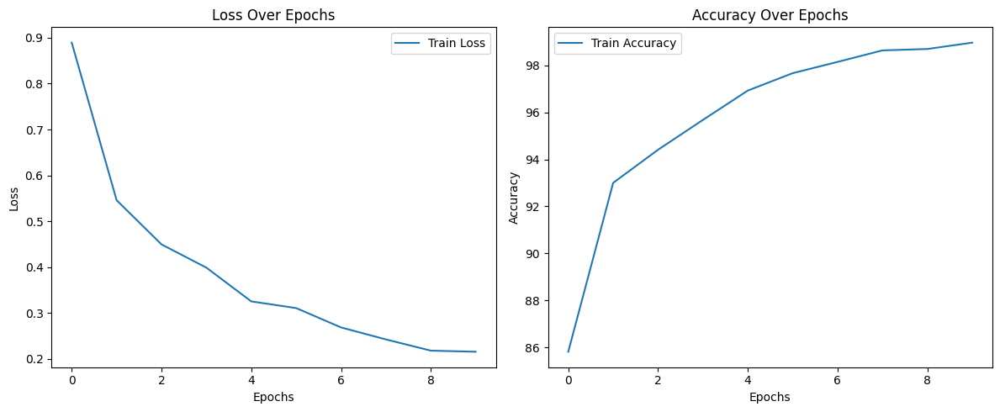

In [42]:
# Plot training and validation loss
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_loss, label="Train Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Loss Over Epochs")
plt.legend()

# Plot training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(train_acc, label="Train Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Accuracy Over Epochs")
plt.legend()

plt.tight_layout()
plt.show()

In [43]:
model.eval()
running_loss = 0.0
correct = 0
total = 0

with torch.no_grad():
    for i, (anchor, positive, negative, labels) in enumerate(train_loader, 0):
        anchor, positive, negative, labels = anchor.to(device), positive.to(device), negative.to(device), labels.to(device)

        # Forward pass
        anchor_out = model(anchor)
        positive_out = model(positive)
        negative_out = model(negative)
        logits = model(anchor)

        # Compute combined loss
        triplet_loss = triplet_loss_fn(anchor_out, positive_out, negative_out)
        cross_entropy_loss = cross_entropy_loss_fn(logits, labels)
        loss = triplet_loss + cross_entropy_loss

        # Update loss
        running_loss += loss.item()

        # Accuracy computation
        _, predicted = logits.max(1)
        correct += predicted.eq(labels).sum().item()
        total += labels.size(0)

    accuracy = 100 * correct / total
    avg_loss = running_loss / (i + 1)
    
    print(f"Test Loss: {avg_loss:.4f},Test Accuracy: {accuracy:.2f}%")


Test Loss: 0.1730,Test Accuracy: 99.39%


# Part IV

#### **d) Effects of Combining Loss Functions**
1. **Improved Generalization**:
   - The triplet loss component forces the network to learn embeddings that generalize well, improving performance on unseen or similar data distributions.

2. **Balanced Optimization**:
   - The cross-entropy component ensures high classification accuracy, while the triplet loss enhances feature representation quality.

3. **Trade-Offs**:
   - The model might not achieve the absolute best test accuracy compared to using cross-entropy loss alone, as some capacity is allocated to optimizing the embeddin


#### **Reasons for Observed Effects**
- **Feature Overlap Reduction**: The combination reduces overlap in feature space for different classes, enhancing generalization and robustness.
- **Joint Training Dynamics**: Training the feature extractor and classifier together harmonizes their objectives, leading to a more balanced representation.g space.

By combining these losses, the model becomes versatile, balancing high classification performance with robust, generalizable embeddings, making it suitable for a wide range of tasks.